* Name: Aakash Thatte
* Roll Number:12041590
* References Used to Complete the Assignment
    * a. https://plotly.com/python/scatter-plots-on-maps/
    * b. https://medium.com/@simplyjk/why-manhattan-distance-formula-doesnt-apply-to-manhattan-7db0ebb1c5f6
    * c. https://www.enjoyalgorithms.com/blog/life-expectancy-prediction-using-linear-regression<br>
    The above (c) site contains code for the second problem, but I have only used it for visualization concepts<br>
    * d. https://medium.com/swlh/interpreting-linear-regression-through-statsmodels-summary-4796d359035a#:~:text=OLS%20is%20a%20common%20technique%20used%20in%20analyzing,producing%20the%20best%20fit%20line%2C%20and%20the%20dataset.

...


# Report

Note: I have not solved the various parts of problem 1 and 2 in the same order as they are in
the PDF. But all parts are present in this notebook.

## **Problem 1:**
There were a lot of outliers, I have removed most of them. Plots like boxplot, violinplot etc have been used to remove them.
Also, I have done the data exploration process in multiple, hence I have commented a lot of code. It also shows the time put into this assignment. Other than features present in the data as well as haversine distance, I have also calculated the manhattan distance (on spherical surface) as a feature that correlates well with fare_amount.

I have tried to approach this problem using three mehtods: 

**1. Closed Form Approach**<br>
Initially, I removed a few outliers and tried using the closed form solution. But that resulted in a very high MSE and I had to process the data again to remove more outliers which were corrupting the results. Also, to accommodate these outliers, the correlation was getting very low. So I had to remove a lot of faulty points. Finally, I got an MSE of about 0.3. I have used cross validation here to train and validate the model on different parts of the data. Then I have used an ensemble achieved from cross validation on the test data. And that ensemble model generalized quite well and MSE was about 0.3, same as when training.
I have not used any library for this approach, wrote my own code.

**2. Non-parametric (KNN based) approach**<br>
In this approach as well, I have just scipy's cdist function to calculate nearest neighbours. But wrote all other code on my own. I choose different values of k and tried to calculate MSE for those values. What I have done is, for each test point, I calculated k nearest points from train data and used their fare_amount mean to assign to the test point. Initially, when k was increased from 2 to 7, I saw a decrease in MSE values.

**3. Stochastic gradient descent**<br>
In this part, I used scikit-learn to setup preprocessing pipelines and the used a SGDRegressor to perform linear regression using stochastic gradient descent.

## **Problem 2:**

In this I load the data, removed all null values, then used pairplots and bubble plots to analyse the correlation and population based life expectancy. I used plotly chloropleth maps to plot life expectancy by country in a world map .I used the mentioned Kolmogorov-Smirnov test to get p-values and checked that only 2 or 3 features resembled a normal distribution around their mean and with sigma = std(feature). Total expenditure and schooling resembled normal distributions. 
I then scaled the data, used linear regression and lasso regression to find that lasso assigned some feature a parameter with 0 value indicating that they are not significant. I used statsmodels.OLS to do further analysis by looking at the p-values. At the end, I performed forward selection using mlextend library.

# Part 1: NY Taxi Fare Prediction

In [59]:
# !pip install -q kaggle

In [60]:
# from google.colab import files
# files.upload()

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"surajkumardsai","key":"c54b2c2d1fdddc8de488315e171fd1f7"}'}

In [61]:
# !mkdir ~/.kaggle
# !cp kaggle.json ~/.kaggle/
# !chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [62]:
# !kaggle competitions download -c new-york-city-taxi-fare-prediction

new-york-city-taxi-fare-prediction.zip: Skipping, found more recently modified local copy (use --force to force download)


In [63]:
# !unzip new-york-city-taxi-fare-prediction

Archive:  new-york-city-taxi-fare-prediction.zip
replace GCP-Coupons-Instructions.rtf? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace sample_submission.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace test.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace train.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n


In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
# !pip install --upgrade matplotlib

In [78]:
# I have already preprocessed and saved the csv files
# with date, day, etc as "Processed_....csv"
# I will directly load those in the cells below
train = pd.read_csv("train_NYTaxi.csv", nrows = 1000000)
test = pd.read_csv("test_NYTaxi.csv")

In [79]:
out = train[(train['pickup_latitude']<-90) | 
      (train['pickup_latitude']>90) |
      (train['dropoff_latitude']>90) |
      (train['dropoff_latitude']<-90) | 
      (train['dropoff_longitude']>180) | 
      (train['dropoff_longitude']<-180) | 
       (train['pickup_longitude']<-180) | 
       (train['pickup_longitude']>180)]
# train[(train['pickup_longitude']<=180) & (train['pickup_longitude']>=-180)]

In [69]:
import plotly.express as px
px.scatter_geo(out,lat=out['pickup_latitude'],lon=out['pickup_longitude'])
# We can see a point completely outside of new york

In [111]:
px.scatter_geo(out,lat=out['dropoff_latitude'],lon=out['dropoff_longitude'])
# We can see a point completely outside of new york

PART 1 --> DATA CLEANSING 

Will perform the following activities
1.   Shape of train and test sets
2.   Check for NaNs and drop them (if any)
3.   Check for outliers and drop them (if any)
4.   Type conversion of relevant fields





In [3]:
train.head()

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,0,2009-04-08 19:11:10.0000004,4.9,2009-04-08 19:11:10 UTC,-73.998287,40.727490,-73.989854,40.735239,2
1,1,2012-07-30 16:19:08.0000003,4.9,2012-07-30 16:19:08 UTC,-73.966597,40.794345,-73.965682,40.803808,2
2,2,2011-02-22 13:35:00.000000121,6.9,2011-02-22 13:35:00 UTC,-73.971638,40.763382,-73.953767,40.783715,1
3,3,2010-10-07 21:09:35.0000002,14.1,2010-10-07 21:09:35 UTC,-74.003545,40.707399,-73.981312,40.750071,1
4,4,2009-10-02 22:51:00.000000140,12.1,2009-10-02 22:51:00 UTC,-74.004532,40.707465,-73.977908,40.745633,5


In [4]:
# Check no of rows & columns in the dataset
print("Shape of the Training data :", train.shape)

# See all the columns in the dataset
print("All columns are :", list(train.columns))

Shape of the Training data : (100000, 9)
All columns are : ['Unnamed: 0', 'key', 'fare_amount', 'pickup_datetime', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count']


In [5]:
# Check datatypes & count of not-null values in each field
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         100000 non-null  int64  
 1   key                100000 non-null  object 
 2   fare_amount        100000 non-null  float64
 3   pickup_datetime    100000 non-null  object 
 4   pickup_longitude   100000 non-null  float64
 5   pickup_latitude    100000 non-null  float64
 6   dropoff_longitude  100000 non-null  float64
 7   dropoff_latitude   100000 non-null  float64
 8   passenger_count    100000 non-null  int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 6.9+ MB


In [7]:
#check for missing values in train data
train.isnull().sum()

Unnamed: 0           0
key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
dtype: int64

In [10]:
#check for missing values in test data
test.isnull().sum()

key                  0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
dtype: int64

In [6]:
#drop the missing values
train.dropna(inplace=True)
test.dropna(inplace=True)

In [12]:
#check the target column
train['fare_amount']

0         4.9
1         4.9
2         6.9
3        14.1
4        12.1
         ... 
99995     4.5
99996    25.5
99997    14.5
99998     9.0
99999    15.0
Name: fare_amount, Length: 100000, dtype: float64

In [13]:
#Look for no. of non-positive fare_amount values.
train[train['fare_amount']<=0]

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
38446,38446,2010-03-13 15:29:10.0000003,-9.3,2010-03-13 15:29:10 UTC,-73.977015,40.779925,-73.949747,40.790322,3
38582,38582,2010-02-27 02:37:10.0000004,-6.9,2010-02-27 02:37:10 UTC,-73.987800,40.747842,-73.981702,40.763600,1
44049,44049,2015-01-25 18:00:06.0000005,0.0,2015-01-25 18:00:06 UTC,-73.801102,40.670094,-73.801086,40.670536,1
55472,55472,2015-02-23 09:34:48.0000002,0.0,2015-02-23 09:34:48 UTC,-73.982201,40.768417,-73.981392,40.764874,1
61165,61165,2010-03-24 14:21:10.0000001,-2.5,2010-03-24 14:21:10 UTC,-73.953752,40.813413,-73.953743,40.813407,1
72873,72873,2015-01-15 07:49:05.0000004,0.0,2015-01-15 07:49:05 UTC,-73.901909,40.763988,-73.901917,40.763969,3


In [80]:
# Remove the non-positive fare_amount values.
train = train[train['fare_amount']>0]
train = train[train['passenger_count']>0]
# trian = train[train['']]


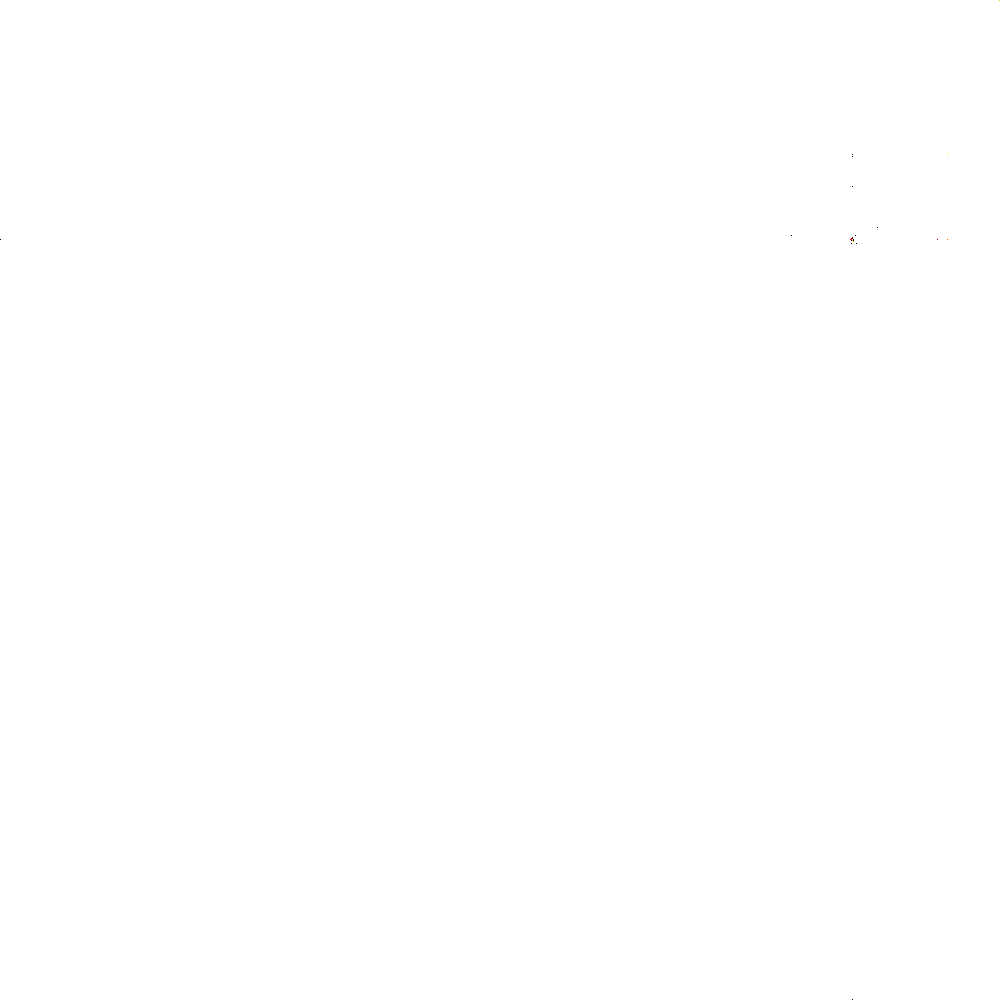

In [10]:
#----------------------Trying to visualize using datashader----------------------------------
# import datashader as ds
# cvs = ds.Canvas(plot_width=1000, plot_height=1000)
# agg = cvs.points(train, x='pickup_longitude', y='pickup_latitude')
# coords_lat, coords_lon = agg.coords['pickup_latitude'].values, agg.coords['pickup_longitude'].values
# # Corners of the image, which need to be passed to mapbox
# coordinates = [[coords_lon[0], coords_lat[0]],
#                [coords_lon[-1], coords_lat[0]],
#                [coords_lon[-1], coords_lat[-1]],
#                [coords_lon[0], coords_lat[-1]]]

# from colorcet import fire
# import datashader.transfer_functions as tf
# img = tf.shade(agg, cmap=fire)[::-1].to_pil()

# import plotly.express as px
# # Trick to create rapidly a figure with mapbox axes
# fig = px.scatter_mapbox(train, lat='pickup_latitude', lon='pickup_longitude', zoom=12)
# # Add the datashader image as a mapbox layer image
# fig.update_layout(mapbox_style="carto-darkmatter",
#                  mapbox_layers = [
#                 {
#                     "sourcetype": "image",
#                     "source": img,
#                     "coordinates": coordinates
#                 }]
# )
# fig.show()
#--------------------------------------------------------------------------------------------

In [15]:
#Remove outliers
# import plotly.express as px

In [16]:
# fig = px.scatter(x=list(range(len(train))), y=train['fare_amount'])
# fig.show()

In [11]:
# Let us remove the outliers in fare
len(train[train['fare_amount']>150])/len(train)
# Only 0.0001% data has fare amount greate than 150

0.00012000720043202592

In [12]:
len(train[train['fare_amount']>175])/len(train)

5.00030001800108e-05

In [13]:
len(train[train['fare_amount']>75])/len(train)
# We can probably set the upper limit of fare as 75
# But there can be cases where the user travelled a lot
# Let us restrict the fare upto 150 to account for higher fares
# We can later remove those if they affect the model

0.0012100726043562614

In [14]:
# train = train[train['fare_amount']<150]

**Next let us explore the pickup latitude and longitudes**, 

Googling gave me this info
*   Latitudes range from -90 to 90.
*   Longitudes range from -180 to 180.

The above describe clearly shows some outliers. Let's filter them


In [81]:
train = train[(train['pickup_latitude']<=90) & (train['pickup_latitude']>=-90)]
train = train[(train['pickup_longitude']<=180) & (train['pickup_longitude']>=-180)]

### Finding outliers using box plots

D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(0.0, 35.0)

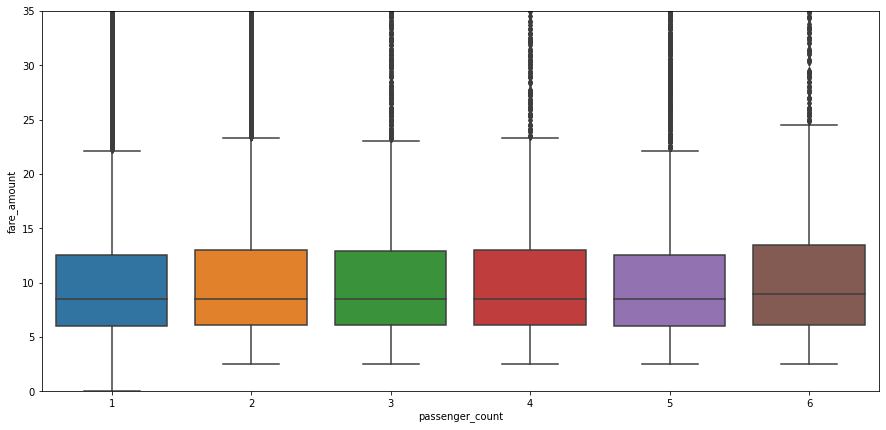

In [13]:
plt.figure(figsize=(15,7))
sns.boxplot(train['passenger_count'],train['fare_amount'])
# As we can see, there are many points outside of interquartile range for passenger_count
plt.ylim(0,35)
# I think we can safely remove points where the fare is above 25

In [82]:
train = train[train['fare_amount']<=25]

In [83]:
len(train)
# So 8 points are removed which were outside of the lat lon range.
# Further some points are removed due to the passenger_count!=0 condition
# Further reduced points

92471

Check the data types of each column

In [16]:
train.dtypes

Unnamed: 0             int64
key                   object
fare_amount          float64
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
dtype: object

key and pickup_datetime seem to be datetime columns which are in object format. Let's convert them to datetime

In [84]:
train.loc[:,'key'].apply(lambda x: pd.to_datetime(x))
train.loc[:,'pickup_datetime'].apply(lambda y: pd.to_datetime(y))

0       2009-04-08 19:11:10+00:00
1       2012-07-30 16:19:08+00:00
2       2011-02-22 13:35:00+00:00
3       2010-10-07 21:09:35+00:00
4       2009-10-02 22:51:00+00:00
                   ...           
99994   2011-03-14 10:09:00+00:00
99995   2015-06-08 07:05:28+00:00
99997   2013-02-02 19:02:00+00:00
99998   2013-12-28 15:44:17+00:00
99999   2014-04-26 19:30:00+00:00
Name: pickup_datetime, Length: 92471, dtype: datetime64[ns, UTC]

In [85]:
#Convert for test data
test.loc[:,'key'].apply(lambda x: pd.to_datetime(x))
test.loc[:,'pickup_datetime'].apply(lambda y: pd.to_datetime(y))

0      2015-01-27 13:08:24+00:00
1      2015-01-27 13:08:24+00:00
2      2011-10-08 11:53:44+00:00
3      2012-12-01 21:12:12+00:00
4      2012-12-01 21:12:12+00:00
                  ...           
9909   2015-05-10 12:37:51+00:00
9910   2015-01-12 17:05:51+00:00
9911   2015-04-19 20:44:15+00:00
9912   2015-01-31 01:05:19+00:00
9913   2015-01-18 14:06:23+00:00
Name: pickup_datetime, Length: 9914, dtype: datetime64[ns, UTC]

In [23]:
#check the dtypes after conversion
train.dtypes

Unnamed: 0             int64
key                   object
fare_amount          float64
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
dtype: object

In [24]:
test.dtypes

key                   object
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
dtype: object

Now, for **EDA**. The following are my considerations - 
1. Does the number of passengers affect the fare? 
2. Does the date and time of pickup affect the fare?
3. Does the day of the week affect the fare?
4. Does the distance travelled affect the fare?

First, let's split the datetime field 'pickup_datetime' to the following - 
* year
* month
* date
* hour
* day of week

Using these we shall calculate the day of the week and come to our conclusions about how pickup_location affects the fare.
Also, create a new field 'distance' to fetch the distance between the pickup and the drop.

In [86]:
# Add columns for year, month, date, hour, day etc
attrs = ['hour','day','date','month','year']
def conv(df):
    df['hour'] = pd.DatetimeIndex(df['pickup_datetime']).hour
    df['day'] = pd.DatetimeIndex(df['pickup_datetime']).day
    df['date'] = pd.DatetimeIndex(df['pickup_datetime']).date
    df['month'] = pd.DatetimeIndex(df['pickup_datetime']).month
    df['year'] = pd.DatetimeIndex(df['pickup_datetime']).year

In [87]:
conv(train)

In [88]:
conv(test)

In [89]:
test.head()

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,date,month,year
0,2015-01-27 13:08:24.0000002,2015-01-27 13:08:24 UTC,-73.973320,40.763805,-73.981430,40.743835,1,13,27,2015-01-27,1,2015
1,2015-01-27 13:08:24.0000003,2015-01-27 13:08:24 UTC,-73.986862,40.719383,-73.998886,40.739201,1,13,27,2015-01-27,1,2015
2,2011-10-08 11:53:44.0000002,2011-10-08 11:53:44 UTC,-73.982524,40.751260,-73.979654,40.746139,1,11,8,2011-10-08,10,2011
3,2012-12-01 21:12:12.0000002,2012-12-01 21:12:12 UTC,-73.981160,40.767807,-73.990448,40.751635,1,21,1,2012-12-01,12,2012
4,2012-12-01 21:12:12.0000003,2012-12-01 21:12:12 UTC,-73.966046,40.789775,-73.988565,40.744427,1,21,1,2012-12-01,12,2012


D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(0.0, 35.0)

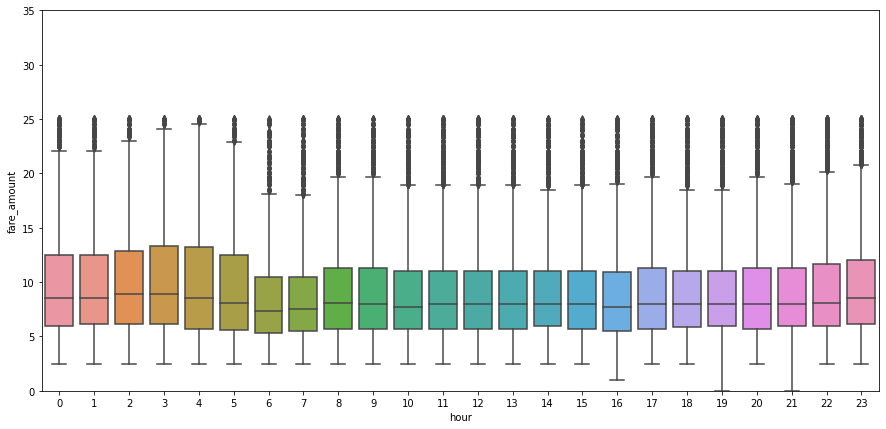

In [23]:
plt.figure(figsize=(15,7))
sns.boxplot(train['hour'],train['fare_amount'])
# As we can see, there are many points outside of interquartile range for passenger_count
plt.ylim(0,35)

D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(0.0, 35.0)

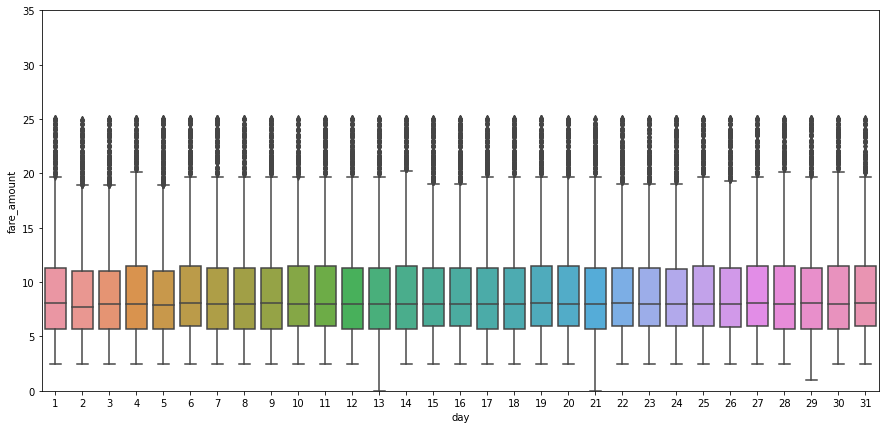

In [24]:
plt.figure(figsize=(15,7))
sns.boxplot(train['day'],train['fare_amount'])
# As we can see, there are many points outside of interquartile range for passenger_count
plt.ylim(0,35)

(-74.01, -73.9)

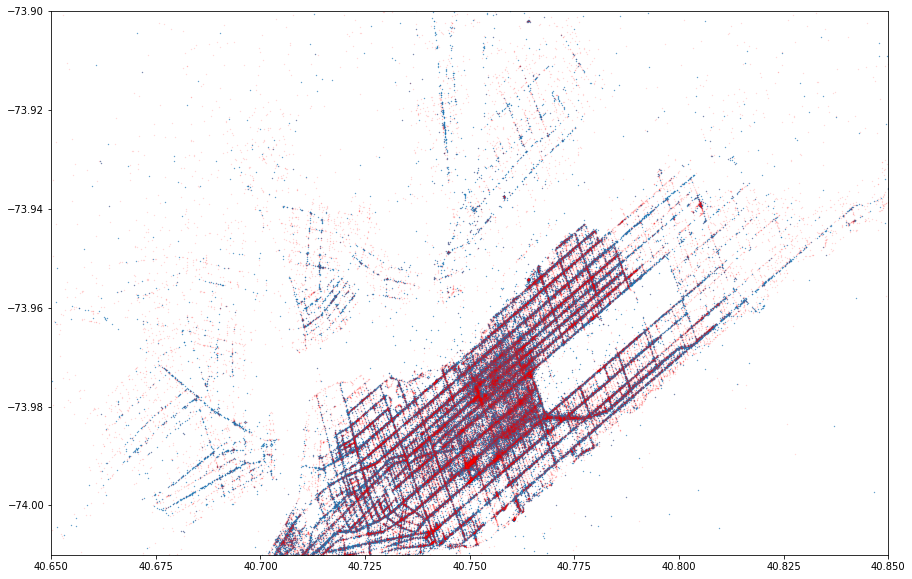

In [71]:
plt.figure(figsize=(15,10))
plt.scatter(train['pickup_latitude'],train['pickup_longitude'],s=0.1)
plt.scatter(train['dropoff_latitude'],train['dropoff_longitude'],s=0.1,c='r',alpha=0.2)
plt.xlim(40.65,40.85)
plt.ylim(-74.01,-73.9)
# We can see a city like structure, the roads maybe, because most of the streets might
# have points where some taxi picked up someone or dropped off someone

In [90]:
len(train)

92471

Text(0, 0.5, 'Dropoff longitude')

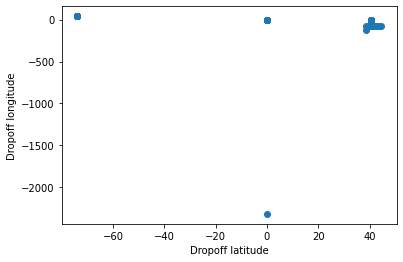

In [93]:
plt.scatter(train['dropoff_latitude'],train['dropoff_longitude'])
plt.xlabel("Dropoff latitude")
plt.ylabel("Dropoff longitude")

In [91]:
# Some more preprocessing on pickup and dropoff latitudes and longitudes
train = train[train['pickup_latitude']<90]
train = train[train['pickup_latitude']>-90]
train = train[train['pickup_longitude']<180]
train = train[train['pickup_longitude']>-180]

In [94]:
train = train[train['dropoff_latitude']<90]
train = train[train['dropoff_latitude']>-90]
train = train[train['dropoff_longitude']<180]
train = train[train['dropoff_longitude']>-180]

In [95]:
len(train)

92470

In [100]:
train.describe()

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,month,year
count,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000,92470.000000
mean,50019.928334,9.156920,-72.470142,39.897931,-72.482627,39.902990,1.684417,13.539645,15.697123,6.253736,2011.710890
std,28875.995311,4.496784,10.584566,6.232723,10.538354,6.218516,1.304874,6.520899,8.701696,3.430405,1.859794
min,0.000000,0.010000,-121.391202,-74.015935,-121.391318,-74.011085,1.000000,0.000000,1.000000,1.000000,2009.000000
25%,24982.250000,5.700000,-73.992432,40.735502,-73.991714,40.735150,1.000000,9.000000,8.000000,3.000000,2010.000000
50%,50078.500000,8.000000,-73.982232,40.752416,-73.980900,40.753211,1.000000,14.000000,16.000000,6.000000,2012.000000
75%,75036.750000,11.300000,-73.969029,40.766462,-73.966235,40.767583,2.000000,19.000000,23.000000,9.000000,2013.000000
max,99999.000000,25.000000,40.801777,42.603366,40.787037,44.640672,6.000000,23.000000,31.000000,12.000000,2015.000000


In [246]:
# print(len(train[train['pickup_latitude']>40.85])) # We can remove this, as it is hardly 0.0012%
# print(len(train[train['pickup_latitude']<0])) # Only 0.0006%, we can also remove these
# print(len(train[train['pickup_longitude']>-5])) # Only 0.02%, we can also remove this
# print(len(train[train['pickup_longitude']<-74.009])) # only 0.02%, we can also remove this

# print(len(train[train['dropoff_latitude']>40.8])) # only 0.03%, we can remove these points too
# print(len(train[train['dropoff_latitude']<40.7])) # We can remove these
# print(len(train[train['dropoff_longitude']>-73.8])) # we can further remove these as well
# print(len(train[train['dropoff_longitude']<-74.01])) # we can also remove these

54


In [251]:
new = train.copy()

In [252]:
new = new[new['pickup_latitude']<40.85]
new = new[new['pickup_latitude']>0]
new = new[new['pickup_longitude']<-5]
new = new[new['pickup_longitude']>-74.009]

new = new[new['dropoff_latitude']<40.8]
new = new[new['dropoff_latitude']>40.7]
new = new[new['dropoff_longitude']<-73.8]
new = new[new['dropoff_longitude']>-74.01]

In [253]:
len(new)
# We have significantly removed the points which seemed to be outliers

80593

In [66]:
# from mpl_toolkits.basemap import Basemap
# import matplotlib.pyplot as plt
# import numpy as np
# # set up orthographic map projection with
# # perspective of satellite looking down at 50N, 100W.
# # use low resolution coastlines.
# map = Basemap(projection='ortho',lat_0=45,lon_0=-100,resolution='l')
# # draw coastlines, country boundaries, fill continents.
# map.drawcoastlines(linewidth=0.25)
# map.drawcountries(linewidth=0.25)
# map.fillcontinents(color='coral',lake_color='aqua')
# # draw the edge of the map projection region (the projection limb)
# map.drawmapboundary(fill_color='aqua')
# # draw lat/lon grid lines every 30 degrees.
# map.drawmeridians(np.arange(0,360,30))
# map.drawparallels(np.arange(-90,90,30))
# # make up some data on a regular lat/lon grid.
# # nlats = 73; nlons = 145; delta = 2.*np.pi/(nlons-1)
# # lats = (0.5*np.pi-delta*np.indices((nlats,nlons))[0,:,:])
# # lons = (delta*np.indices((nlats,nlons))[1,:,:])
# lats = train['pickup_latitude']
# lons = train['pickup_longitude']
# wave = 0.75*(np.sin(2.*lats)**8*np.cos(4.*lons))
# mean = 0.5*np.cos(2.*lats)*((np.sin(2.*lats))**2 + 2.)
# # compute native map projection coordinates of lat/lon grid.
# x, y = map(lons*180./np.piNo module named 'mpl_toolkits.basemap', lats*180./np.pi)
# # contour data over the map.
# cs = map.contour(x,y,wave+mean,15,linewidths=1.5)
# plt.title('contour lines over filled continent background')
# plt.show()

In [101]:
# train[train['pickup_longitude']<-70]

In [34]:
# import plotly.express as px
# import pandas as pd

# fig = px.scatter_geo(train,lat='pickup_latitude',lon='pickup_longitude', color="passenger_count",size="passenger_count")
# fig = px.scatter_geo(train,lat='dropoff_latitude',lon='dropoff_longitude', color="passenger_count",size="passenger_count")
# fig.update_layout(title = 'Pickup and dropoff New York Taxi', title_x=0.5)
# fig.show()

In [10]:
# p_train = p_train[(p_train['passenger_count']!=0) & (p_train['fare_amount']>0)]

In [ ]:
# Let us now add the haversine stuff

We can calulate the distance in a sphere when latitudes and longitudes are given by [Haversine formula](https://en.wikipedia.org/wiki/Haversine_formula)

**haversine(θ) = sin²(θ/2)**

Eventually, the formual boils down to the following where φ is latitude, λ is longitude, R is earth’s radius (mean radius = 6,371km) to include latitude and longitude coordinates (A and B in this case).

**a = sin²((φB - φA)/2) + cos φA . cos φB . sin²((λB - λA)/2)**

**c = 2 * atan2( √a, √(1−a) )**

**d = R ⋅ c**

**d = Haversine distance**

*Refer [this](https://community.esri.com/groups/coordinate-reference-systems/blog/2017/10/05/haversine-formula) page for more info and examples on Haversine formula*

Is this distance equal to the road travel distance? Do we have to do something else?


In [104]:
def haversine_distance(lat1, long1, lat2, long2):
    # I will change this to p_train and p_test
    data = [train, test]
    for i in data:
        R = 6371  #radius of earth in kilometers
        phi1 = np.radians(i[lat1])
        phi2 = np.radians(i[lat2])
    
        delta_phi = np.radians(i[lat2]-i[lat1])
        delta_lambda = np.radians(i[long2]-i[long1])
    
        #a = sin²((φB - φA)/2) + cos φA . cos φB . sin²((λB - λA)/2)
        a = np.sin(delta_phi / 2.0) ** 2 + np.cos(phi1) * np.cos(phi2) * np.sin(delta_lambda / 2.0) ** 2
    
        #c = 2 * atan2( √a, √(1−a) )
        c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    
        #d = R*c
        d = (R * c) #in kilometers
        i['H_Distance'] = d
    print("Haversine added successfully.")

In [105]:
haversine_distance('pickup_latitude', 'pickup_longitude', 'dropoff_latitude', 'dropoff_longitude')

Haversine added successfully.


In [106]:
train.head()
# That's great, we now have H_distance column as well

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,date,month,year,H_Distance
0,0,2009-04-08 19:11:10.0000004,4.9,2009-04-08 19:11:10 UTC,-73.998287,40.727490,-73.989854,40.735239,2,19,8,2009-04-08,4,2009,1.116850
1,1,2012-07-30 16:19:08.0000003,4.9,2012-07-30 16:19:08 UTC,-73.966597,40.794345,-73.965682,40.803808,2,16,30,2012-07-30,7,2012,1.055053
2,2,2011-02-22 13:35:00.000000121,6.9,2011-02-22 13:35:00 UTC,-73.971638,40.763382,-73.953767,40.783715,1,13,22,2011-02-22,2,2011,2.715959
3,3,2010-10-07 21:09:35.0000002,14.1,2010-10-07 21:09:35 UTC,-74.003545,40.707399,-73.981312,40.750071,1,21,7,2010-10-07,10,2010,5.101370
4,4,2009-10-02 22:51:00.000000140,12.1,2009-10-02 22:51:00 UTC,-74.004532,40.707465,-73.977908,40.745633,5,22,2,2009-10-02,10,2009,4.800593


In [255]:
new.corr()['fare_amount']

Unnamed: 0           0.005292
fare_amount          1.000000
pickup_longitude     0.007426
pickup_latitude     -0.006883
dropoff_longitude    0.145849
dropoff_latitude    -0.083673
passenger_count      0.011276
hour                -0.006273
day                  0.005240
month                0.029623
year                 0.149349
H_Distance           0.036374
Name: fare_amount, dtype: float64

In [263]:
new_small = new[new['H_Distance']<15]

In [266]:
# len(new_small)

In [267]:
# new_small.corr()['fare_amount']

(0.0, 30.0)

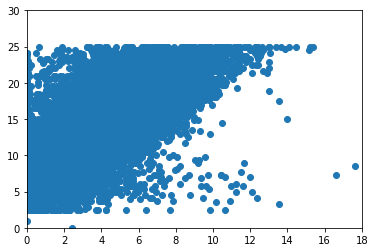

In [269]:
plt.scatter(new['H_Distance'],new['fare_amount'])
plt.xlim(0,18)
plt.ylim(0,30)
# The outliers are affecting the correlation badly, so I have removed them in new_small

In [268]:
new_small.corr()['fare_amount']
# Has a good correlation with H_Distance

Unnamed: 0           0.005243
fare_amount          1.000000
pickup_longitude     0.075524
pickup_latitude     -0.047854
dropoff_longitude    0.145022
dropoff_latitude    -0.083820
passenger_count      0.011387
hour                -0.006429
day                  0.005237
month                0.029592
year                 0.149598
H_Distance           0.813178
Name: fare_amount, dtype: float64

In [270]:
new_small.to_csv("new_small.csv")

In [ ]:
# I have already done with the above mentioned stuff, so I will comment out the cell below

In [104]:
# data = [train,test]
# for i in data:
#     i['Year'] = i['pickup_datetime'].dt.year
#     i['Month'] = i['pickup_datetime'].dt.month
#     i['Date'] = i['pickup_datetime'].dt.day
#     i['Day of Week'] = i['pickup_datetime'].dt.dayofweek
#     i['Hour'] = i['pickup_datetime'].dt.hour

In [17]:
# train.head()

**1. Does the number of passengers affect the fare?**

D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='passenger_count', ylabel='fare_amount'>

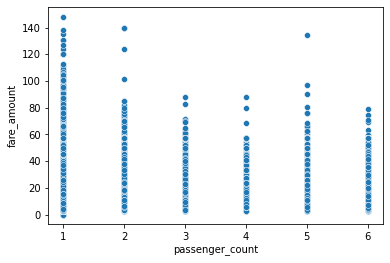

In [16]:
sns.scatterplot(p_train['passenger_count'],p_train['fare_amount'])
# As these plots do not give us much idea about outpiers,
# I will further box plots or violin plots

**2. Does the date and time of pickup affect the fare?**

In [ ]:
plt.scatter(p_train[''])

**3. Does the day of the week affect the fare?**

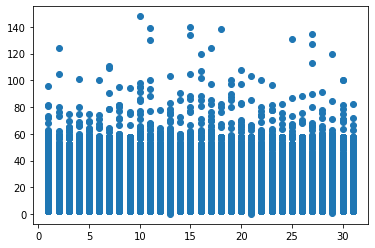

In [18]:
plt.scatter(p_train['day'],p_train['fare_amount'])
# Well, the day of week does not seem to have that much impact
# Though I expected that weekend costs would be high

# Weekends may cause a shift in our model

**4. Does the month affect the fare?**

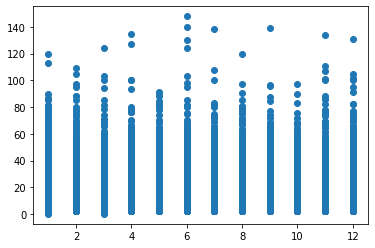

In [19]:
plt.scatter(p_train['month'],p_train['fare_amount'])

**5. Does the distance affect the fare?**

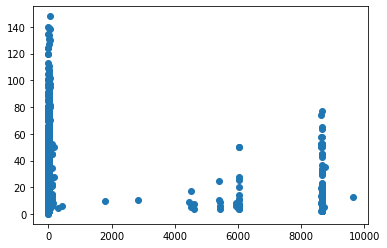

In [21]:
plt.scatter(p_train['H_Distance'],p_train['fare_amount'])

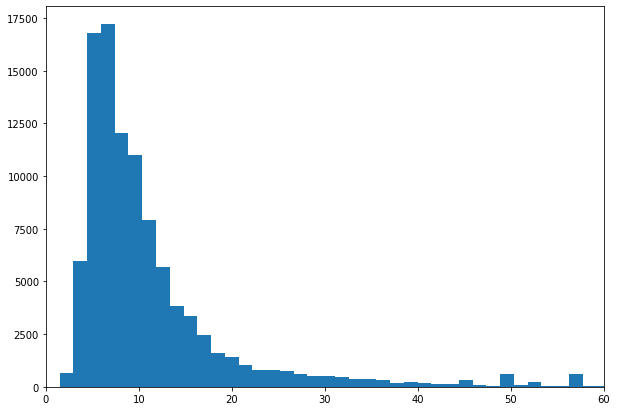

In [79]:
plt.figure(figsize=(10,7))
plt.hist(p_train['fare_amount'],bins=100)
plt.xlim(0,60);
# The instances that the fare amount will be very high are very very less

In [23]:
# len(p_train['H_Distance'].unique())
# Need to visualize this in parts maybe

96747

In [26]:
# Let us find the max haversine distance
# from sklearn.metrics.pairwise import haversine_distances
# from math import radians

In [27]:
# p1 = [-90,-180]
# p2 = [90,180]
# p1 = [radians(_) for _ in p1]
# p2 = [radians(_) for _ in p2]
# result = haversine_distances([p1, p2])

In [29]:
# result* 6371000/1000 

array([[    0.        , 20015.08679602],
       [20015.08679602,     0.        ]])

In [30]:
# max_h = 20015.08679602

In [34]:
# p_train[p_train['H_Distance']>max_h]
# p_train['H_Distance'].max()

9640.45783303612

In [15]:
# (I am saving the processed files again and again so as to save from kernel crashes)
# p_train.to_csv("Final_train.csv")
# p_test.to_csv("Final_test.csv")

#### Load the final train and test csv

In [2]:
# train_final = pd.read_csv("Final_train.csv")
# test_final = pd.read_csv("Final_test.csv")

In [3]:
# train_final.drop(['Unnamed: 0','Unnamed: 0.1'],axis=1,inplace=True)

In [4]:
# test_final.drop('Unnamed: 0',axis=1,inplace=True)

In [5]:
# len(train_final)

99609

In [14]:
pl_df = train_final[['hour','month','year','day','passenger_count','H_Distance','fare_amount']]

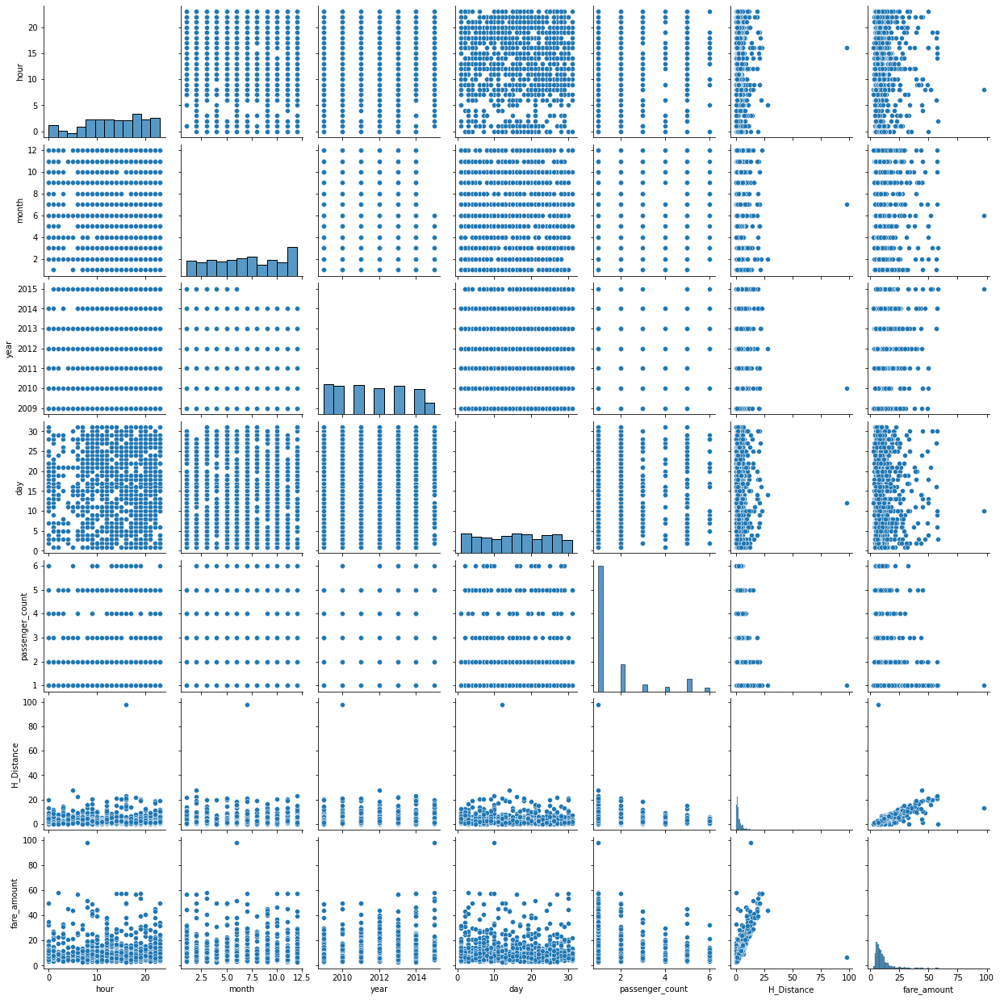

In [15]:
sns.pairplot(pl_df.sample(1000))

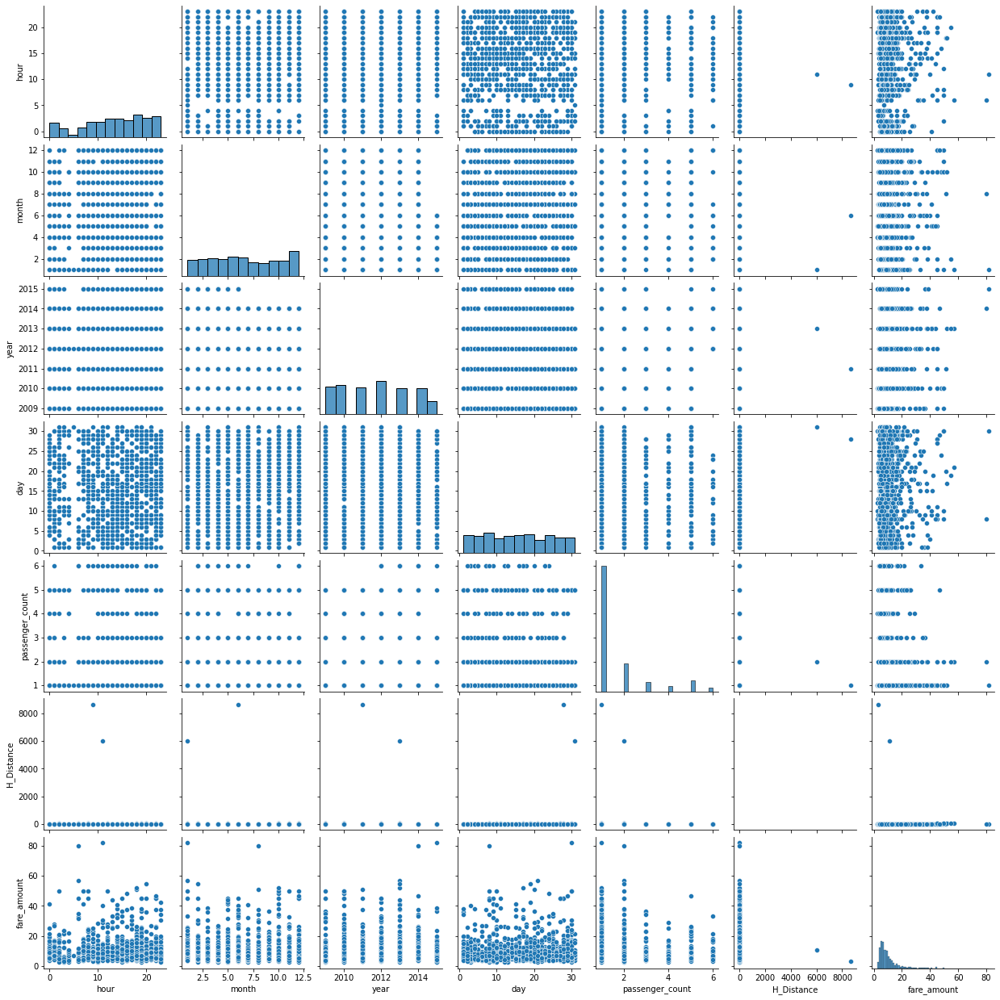

In [16]:
sns.pairplot(pl_df.sample(1000))
# We can see some positive correlation between H_Distance and fare_amount

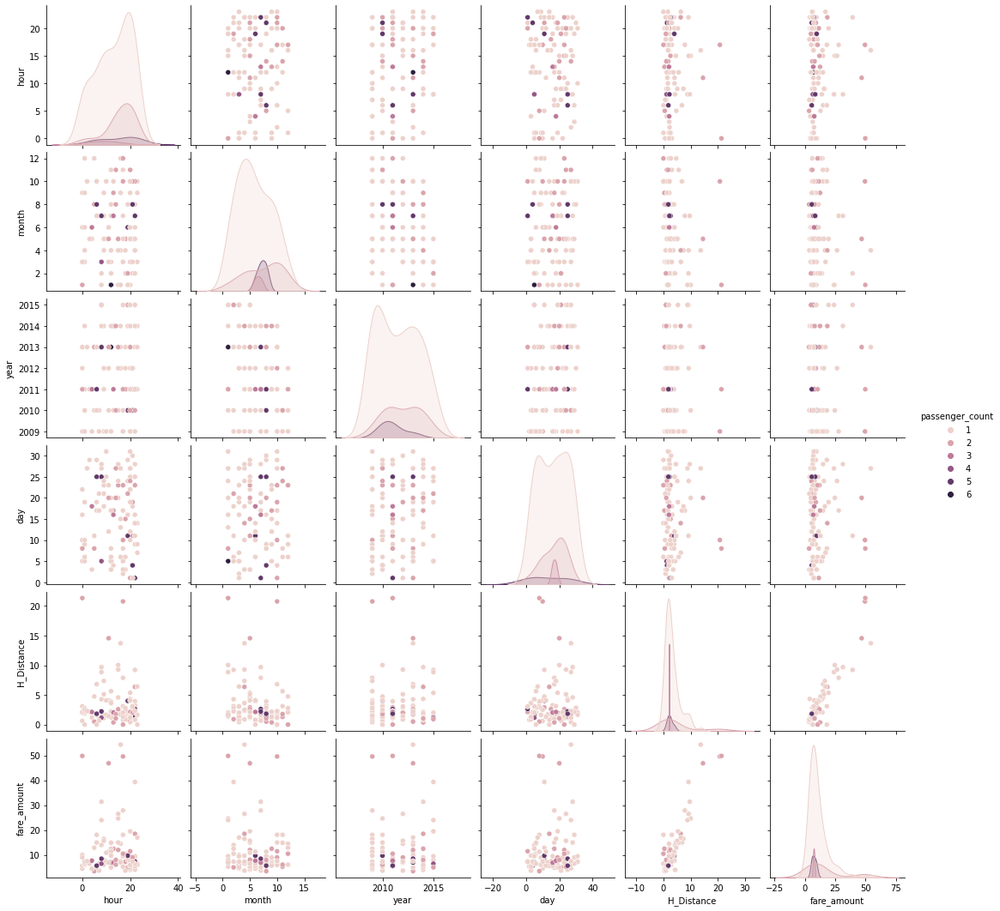

In [17]:
sns.pairplot(pl_df.sample(100),hue="passenger_count")

In [18]:
# This was when I had not removed enough outpiers
# After removing outliers and after multiple iterations of
# checking the data, I had to remove a lot of points.

train_final.corr()
# Here, we can see a correlation of 0.11 with year and fare_amount
# Also hour of day has a negative correlation, But I will have to further check this
# As prices are usually very high at odd times like 23:00 pm and such

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,month,year,H_Distance
fare_amount,1.000000,0.006739,-0.006432,0.004230,-0.005181,0.015318,-0.020088,0.002737,0.023871,0.116023,0.020405
pickup_longitude,0.006739,1.000000,-0.976747,0.792410,-0.939304,0.006173,-0.001255,0.010774,-0.000705,0.005643,0.161341
pickup_latitude,-0.006432,-0.976747,1.000000,-0.781412,0.963510,-0.008373,0.000090,-0.013243,0.002514,-0.008441,-0.134963
dropoff_longitude,0.004230,0.792410,-0.781412,1.000000,-0.801395,0.006558,-0.003005,0.004667,0.001037,0.006563,0.060642
dropoff_latitude,-0.005181,-0.939304,0.963510,-0.801395,1.000000,-0.008614,0.000728,-0.012771,0.001467,-0.010827,-0.111568
passenger_count,0.015318,0.006173,-0.008373,0.006558,-0.008614,1.000000,0.023204,0.001553,0.004443,0.002709,-0.001769
hour,-0.020088,-0.001255,0.000090,-0.003005,0.000728,0.023204,1.000000,-0.001396,-0.006409,0.002602,-0.002321
day,0.002737,0.010774,-0.013243,0.004667,-0.012771,0.001553,-0.001396,1.000000,-0.018096,-0.005039,0.004291
month,0.023871,-0.000705,0.002514,0.001037,0.001467,0.004443,-0.006409,-0.018096,1.000000,-0.116685,-0.004626
year,0.116023,0.005643,-0.008441,0.006563,-0.010827,0.002709,0.002602,-0.005039,-0.116685,1.000000,0.024326


#### Trying to add manhattan distance and then see if there is better correlation of manhattan distance with fare_amount

In [271]:
def md(lat1,lon1,lat2,lon2):
    return abs(lat1-lat2)+abs(lon1-lon2)

In [24]:
# This column should be removed as it assumes flat surface
# train_final['manhattan'] = train_final.apply(
# lambda x:md(x.pickup_latitude,x.pickup_longitude,x.dropoff_latitude,x.dropoff_longitude), axis=1
# )

In [26]:
md(40.727490,-73.998287,40.735239,-73.989854)
# So, manhattan distance has been added
# But this does not take into account the curvature, so I will have to add another one

0.01618200000000769

In [28]:
import numpy as np
def haversine(lat1, lon1, lat2, lon2):     
    R = 3958.76 # Earth radius in miles          
    dLat, dLon, lat1, lat2 = np.radians(lat2 - lat1), np.radians(lon2 - lon1),   np.radians(lat1), np.radians(lat2)     
    
    a =  np.sin(dLat/2) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(dLon/2) ** 2     
    c = 2 * np.arcsin(np.sqrt(a))          
    return R * c

def manhattan_dist(lat1, lon1, lat2, lon2):
    
    # Pickup coordinates
    p = np.stack([lat1, lon1], axis = 1)
    
    # Dropoff coordinates
    d = np.stack([lat2, lon2], axis = 1)
    
    theta1 = np.radians(-28.904)
    theta2 = np.radians(28.904)
    
    ## Rotation matrix
    R1 = np.array([[np.cos(theta1), np.sin(theta1)], 
                   [-np.sin(theta1), np.cos(theta1)]]
                 )
    R2 = np.array([[np.cos(theta2), np.sin(theta2)], 
                   [-np.sin(theta2), np.cos(theta2)]]
                 )
    
    # Rotate Pickup and Dropoff coordinates by -29 degress in World2
    pT = R1 @ p.T  
    dT = R1 @ d.T  
    
    # Coordinates of Hinge point in the rotated world 
    vT = np.stack((pT[0,:], dT[1,:]))
    # Coordinates of Hinge point in the real world 
    v = R2 @ vT
    """ Finally,
    
    Manhattan distance 
            = 
    Haversine dist between Pickup & Hingept
            +
    Haversine dist between Hinge pt & Dropoff location 
    """
    
    return (haversine(p.T[0], p.T[1], v[0], v[1]) + 
            haversine(v[0], v[1], d.T[0], d.T[1])
           )

In [29]:
new_small['manhattan_dist'] = manhattan_dist(
new_small['pickup_latitude'], new_small['pickup_longitude'], 
new_small['dropoff_latitude'], new_small['dropoff_longitude']
)

In [30]:
new_small.head()

,Unnamed: 0,Unnamed: 0.1,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,date,month,year,H_Distance,manhattan_dist
0,0,0,2009-04-08 19:11:10.0000004,4.9,2009-04-08 19:11:10 UTC,-73.998287,40.727490,-73.989854,40.735239,2,19,8,2009-04-08,4,2009,1.116850,0.808619
1,2,2,2011-02-22 13:35:00.000000121,6.9,2011-02-22 13:35:00 UTC,-73.971638,40.763382,-73.953767,40.783715,1,13,22,2011-02-22,2,2011,2.715959,2.044722
2,3,3,2010-10-07 21:09:35.0000002,14.1,2010-10-07 21:09:35 UTC,-74.003545,40.707399,-73.981312,40.750071,1,21,7,2010-10-07,10,2010,5.101370,4.018520
3,4,4,2009-10-02 22:51:00.000000140,12.1,2009-10-02 22:51:00 UTC,-74.004532,40.707465,-73.977908,40.745633,5,22,2,2009-10-02,10,2009,4.800593,3.715390
4,5,5,2009-10-07 08:40:00.00000096,21.3,2009-10-07 08:40:00 UTC,-73.958883,40.780737,-73.995530,40.723353,1,8,7,2009-10-07,10,2009,7.088301,5.523574


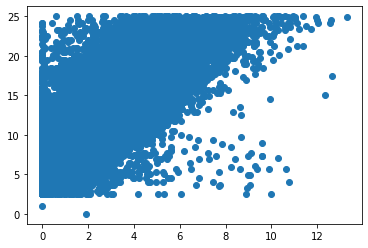

In [275]:
plt.scatter(new_small['manhattan_dist'],new_small['fare_amount'])
# That is amazing, even the manhattan distance is having a good correlation with fare_amount

In [277]:
new_small.corr()['fare_amount']
# The manhattan_dist (Which is the corrected manhattan distance) has a better correlation than H_distance

Unnamed: 0           0.005243
fare_amount          1.000000
pickup_longitude     0.075524
pickup_latitude     -0.047854
dropoff_longitude    0.145022
dropoff_latitude    -0.083820
passenger_count      0.011387
hour                -0.006429
day                  0.005237
month                0.029592
year                 0.149598
H_Distance           0.813178
manhattan_dist       0.801117
Name: fare_amount, dtype: float64

In [279]:
# test['manhattan_dist'] = manhattan_dist(
# test['pickup_latitude'], test_final['pickup_longitude'], 
# test_final['dropoff_latitude'], test_final['dropoff_longitude']
# )

In [13]:
# Saving files to avoid any loss due to crashes
# train_final.to_csv("train_ready.csv")
# test_final.to_csv("test_ready.csv")

In [2]:
# train_final = pd.read_csv("train_ready.csv")
# test_final = pd.read_csv("test_ready.csv")

D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='passenger_count', ylabel='fare_amount'>

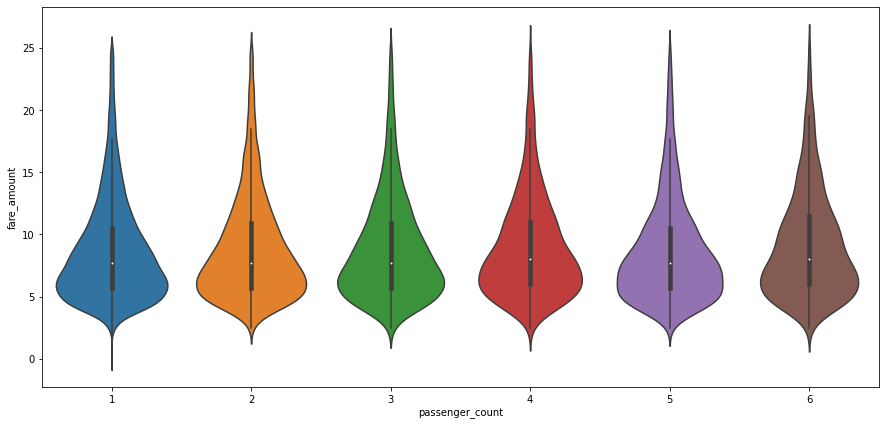

In [280]:
# Trying to check using violin plots
plt.figure(figsize=(15,7))
sns.violinplot(new_small['passenger_count'],new_small['fare_amount'])
# This shows we have removed all outliers

D:\anaconda_dist\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(0.0, 35.0)

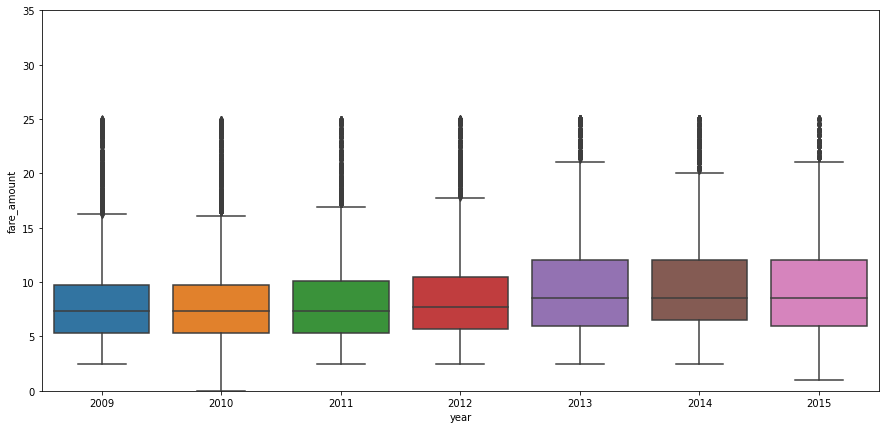

In [281]:
plt.figure(figsize=(15,7))
sns.boxplot(new_small['year'],new_small['fare_amount'])
plt.ylim(0,35)
# As we can expect, the average prices increase over the years

In [2]:
from sklearn.model_selection import train_test_split
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error

### First using the closed form solution, as in our case, d=7, so the A transpose A will be 8x8, not very large to have issues

###### I will do 10 fold cross validation. So, this will give us 10 models. We can then use all these models while predicting, and take the mean/average of all of their results, this will work like an ensemble of models.

In [31]:
# Doing k-fold cross with k = 10
# First, I will split the clean data in 10 parts
# Then perform cross validation
# new_small.to_csv("new_small.csv")

In [2]:
# Load new_small
new_small = pd.read_csv("new_small.csv")
new_selected = new_small[['fare_amount','manhattan_dist','H_Distance','passenger_count','day','month','hour','year']]

In [43]:
new_small.head()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,date,month,year,H_Distance,manhattan_dist
0,0,0,0,2009-04-08 19:11:10.0000004,4.9,2009-04-08 19:11:10 UTC,-73.998287,40.727490,-73.989854,40.735239,2,19,8,2009-04-08,4,2009,1.116850,0.808619
1,1,2,2,2011-02-22 13:35:00.000000121,6.9,2011-02-22 13:35:00 UTC,-73.971638,40.763382,-73.953767,40.783715,1,13,22,2011-02-22,2,2011,2.715959,2.044722
2,2,3,3,2010-10-07 21:09:35.0000002,14.1,2010-10-07 21:09:35 UTC,-74.003545,40.707399,-73.981312,40.750071,1,21,7,2010-10-07,10,2010,5.101370,4.018520
3,3,4,4,2009-10-02 22:51:00.000000140,12.1,2009-10-02 22:51:00 UTC,-74.004532,40.707465,-73.977908,40.745633,5,22,2,2009-10-02,10,2009,4.800593,3.715390
4,4,5,5,2009-10-07 08:40:00.00000096,21.3,2009-10-07 08:40:00 UTC,-73.958883,40.780737,-73.995530,40.723353,1,8,7,2009-10-07,10,2009,7.088301,5.523574


In [3]:
time_encoded = pd.get_dummies(new_small['hour'])

In [7]:
encoded_hour_df = pd.concat([new_small,time_encoded],axis=1)

In [9]:
encoded_hour_df.columns

Index([       'Unnamed: 0',      'Unnamed: 0.1',    'Unnamed: 0.1.1',
                     'key',       'fare_amount',   'pickup_datetime',
        'pickup_longitude',   'pickup_latitude', 'dropoff_longitude',
        'dropoff_latitude',   'passenger_count',              'hour',
                     'day',              'date',             'month',
                    'year',        'H_Distance',    'manhattan_dist',
                         0,                   1,                   2,
                         3,                   4,                   5,
                         6,                   7,                   8,
                         9,                  10,                  11,
                        12,                  13,                  14,
                        15,                  16,                  17,
                        18,                  19,                  20,
                        21,                  22,                  23],
      dtype='object

In [10]:
new_encoded_selected = encoded_hour_df[['fare_amount','manhattan_dist','H_Distance','passenger_count',
                                       0,                   1,                   2,
                         3,                   4,                   5,
                         6,                   7,                   8,
                         9,                  10,                  11,
                        12,                  13,                  14,
                        15,                  16,                  17,
                        18,                  19,                  20,
                        21,                  22,                  23
                                       ]]

In [11]:
new_encoded_selected

,fare_amount,manhattan_dist,H_Distance,passenger_count,0,1,2,3,4,5,...,14,15,16,17,18,19,20,21,22,23
0,4.9,0.808619,1.116850,2,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,6.9,2.044722,2.715959,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,14.1,4.018520,5.101370,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,12.1,3.715390,4.800593,5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
4,21.3,5.523574,7.088301,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80547,3.7,0.063062,0.080607,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
80548,4.5,1.189864,1.198577,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
80549,14.5,2.214189,2.808335,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
80550,9.0,2.041955,2.076158,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0


In [18]:
# numeric_transformer = Pipeline(steps=[
#        ('imputer', SimpleImputer(strategy='mean'))
#       ,('scaler', StandardScaler())
# ])
# categorical_transformer = Pipeline(steps=[
#        ('imputer', SimpleImputer(strategy='constant'))
#       ,('encoder', OrdinalEncoder())
# ])
# numeric_features = ['passenger_count','H_Distance','manhattan_dist']
# categorical_features = ['day','month','year','hour']
# preprocessor = ColumnTransformer(
#    transformers=[
#     ('numeric', numeric_transformer, numeric_features)
#    ,('categorical', categorical_transformer, categorical_features)
# ]) 
# from sklearn.linear_model import SGDRegressor
# pipeline = Pipeline(steps = [
#                ('preprocessor', preprocessor)
#            ])

In [24]:
# Define which columns should be encoded vs scaled
from sklearn.preprocessing import OneHotEncoder
columns_to_encode = ['fare_amount','manhattan_dist','H_Distance','passenger_count']
columns_to_scale  = ['day','month','hour','year']

# Instantiate encoder/scaler
scaler = StandardScaler()
ohe    = OneHotEncoder(sparse=False)

# Scale and Encode Separate Columns
scaled_columns  = scaler.fit_transform(new_small[columns_to_scale]) 
encoded_columns =    ohe.fit_transform(new_small[columns_to_encode])

new_scaled_encoded = pd.concat([scaled_columns, encoded_columns], axis=1)

MemoryError: Unable to allocate 96.1 GiB for an array with shape (80552, 160182) and data type float64

In [ ]:
new

In [12]:
data_10 = np.array_split(new_encoded_selected,10)

In [13]:
# Here I will perform the cross validation
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error
# I will store the weights for each part of the cross validation, just in case we need them further
weights = []

# Also, I will test each model on the test set and either choose the one with lowest error(MSE)
# or choose all models and pick the average of their predictions
loss_MSE = []

for i in range(10):
    #--------------------------NOTE----------------------------------------#
    # There are some print statements that I had used to debug the code.   #
    # The same can be used for checking the dimensions of feature.         # 
    # You can uncomment them and check the dimensions of various matrices. #
    # matrix and target vector etc.                                        # 
    #----------------------------------------------------------------------#
    
    # I am using two different scalers for X and y as standard scaler
    # expects inputs as (n_samples,n_features)
    # So it will be give error on X and y if we use the same one
    scalerx = StandardScaler()
    scalery = StandardScaler()
    
    # Keep one fold aside each time as a test set
    # and use others as train set, that's what k-fold is basically
    train_frames = [data_10[p] for p in range(10) if p!=i]
    test_frame = data_10[i]
    
    # A combined dataframe of all train folds
    all_val = pd.concat(train_frames)

    # Selecting the dependent and independent variables in the training set
    X = all_val.drop('fare_amount',axis=1)
    y = all_val['fare_amount']
    
    # Scaling the features, so that it is easier to interpret intercept term
    # as expected value of Yi when predictors are set to 0
    X_scaled = scalerx.fit_transform(X)
    X_scaled = np.array(X_scaled)
    
    y = np.array([y])
    y = y.reshape(y.shape[1],y.shape[0])
    y = scalery.fit_transform(y)
    
    print(f"Model-{i+1}")
    print("Shape of X.T",X_scaled.T.shape)
    print("Shape of X",X_scaled.shape)
    print("Shape of X.T@X inverse",np.linalg.inv(X_scaled.T@X_scaled).shape)
    print("Shape of y",y.shape)
    print("--------------------------------------------------")
    w = np.linalg.inv(X_scaled.T@X_scaled)@X_scaled.T@y
#     print(w.shape)

    weights.append(w)
    
    X_test = pd.DataFrame(test_frame)
#     print(X_test)
    y_test = X_test['fare_amount']
    X_test = X_test.drop('fare_amount',axis=1)
    
    # Here we only use transform, not fit transform.
    # It uses the same mean and variance as calculated by fit_transform 
    # to transform the values
    X_test_scaled = scalerx.transform(X_test)
    X_test_scaled = np.array(X_test_scaled)
    
    y_test = np.array([y_test])
    y_test = y_test.reshape(y_test.shape[1],y_test.shape[0])
    # Here we only use transform, not fit transform.
    # It uses the same mean and variance as calculated by fit_transform 
    # to transform the values
    y_test = scalery.transform(y_test) 
    
#     print("Shape of X_test",X_test_scaled.shape)
#     print("Shape of y is",y_test.shape)
#     print("Shape of W is",w.shape)
#     print(f"Now getting predictions of model {i+1}...")

    y_pred = X_test_scaled@w
    mse = mean_squared_error(y_test,y_pred)
    mape = mean_absolute_percentage_error(y_test,y_pred)
    loss_MSE.append(mse)
    print(f"MSE for model {i+1}:",mse)
    print("--------------------------------------------------")
    print(f"MAPE for model {i+1}:",mape)
    print("==================================================")
    
    # Initially, I had not scaled y values, after scaling them, MSE loss has decreases
    # Earlier, it was in the range of 100s
    # Finally I am getting less than 1 MSE values, earlier I was doing the mistake of
    # also including target values in X, that was a blunder 😂.

D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


Model-1
Shape of X.T (27, 72496)
Shape of X (72496, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72496, 1)
--------------------------------------------------
MSE for model 1: 0.34044644723068335
--------------------------------------------------
MAPE for model 1: 1.1163319688156421
Model-2
Shape of X.T (27, 72496)
Shape of X (72496, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72496, 1)
--------------------------------------------------


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


MSE for model 2: 0.3152120943932133
--------------------------------------------------
MAPE for model 2: 1.061663810071897
Model-3
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.

MSE for model 3: 0.7136490945276271
--------------------------------------------------
MAPE for model 3: 2.152771196395849
Model-4
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 4: 0.3505311666743724
--------------------------------------------------
MAPE for model 4: 1.13831312932205
Model-5
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 5: 0.31961618516571394
--------------------------------------------------
MAPE for model 5: 1.1045290305165651
Model-6
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.

MSE for model 6: 0.3173423289145086
--------------------------------------------------
MAPE for model 6: 1.0972987775682665
Model-7
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 7: 0.33268794941747
--------------------------------------------------
MAPE for model 7: 1.0927371977433908


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


Model-8
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 8: 0.3204526490946524
--------------------------------------------------
MAPE for model 8: 1.0863322916071376
Model-9
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 9: 0.35370737321183693
--------------------------------------------------
MAPE for model 9: 1.1150768483602047


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.

Model-10
Shape of X.T (27, 72497)
Shape of X (72497, 27)
Shape of X.T@X inverse (27, 27)
Shape of y (72497, 1)
--------------------------------------------------
MSE for model 10: 0.3269811918186122
--------------------------------------------------
MAPE for model 10: 1.0836440618760705


D:\anaconda_dist\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


In [23]:
# As we can see above, the mean squared loss has further decreased that what it was previously
# without removing many outliers

In [7]:
test = pd.read_csv("test_ready.csv") # Use test_ready.csv to make predictions
len(test)

9914

In [38]:
len(new_small)

80552

In [8]:
# Trying the ensemble
test_selected = new_small[['fare_amount','manhattan_dist','H_Distance','passenger_count','day','month','hour','year']].sample(10000)
# test_scaled = scalerx.transform(test_selected)
x_test = test_selected.drop('fare_amount',axis=1)
y_test = test_selected['fare_amount']
x_scaled = scalerx.transform(x_test)
# y = y.reshape(y.shape[1],y.shape[0])
y_test = np.array([y_test])
y_test = y_test.reshape(y_test.shape[1],y_test.shape[0])
y_scaled = scalery.transform(y_test)
y_pred = None
print("Shape of x_scaled:",x_scaled.shape)
print("Shape of y_scaled:",y_scaled.shape)
for w in weights:
#     print("Shape of w:",w.shape)
#     print(f"Model {}")
    y_cal = x_scaled@w
    if y_pred is None:
        y_pred = y_cal
    else:
        y_pred+=y_cal
print("We have averaged over all results of the 10 models")
print("MSE of the ensemble approach is:",mean_squared_error(y_scaled,y_pred/10))
print("MAPE of the ensemble approach is:",mean_absolute_percentage_error(y_scaled, y_pred/10))

Shape of x_scaled: (10000, 7)
Shape of y_scaled: (10000, 1)
We have averaged over all results of the 10 models
MSE of the ensemble approach is: 0.32857270843702263
MAPE of the ensemble approach is: 1.0667835687191503


(0.0, 250.0)

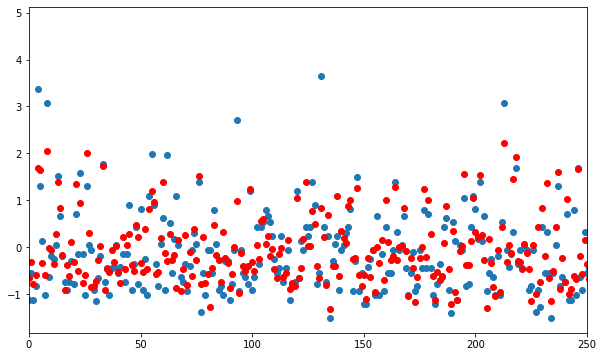

In [15]:
plt.figure(figsize=(10,6))
plt.scatter(list(range(len(y_scaled))),y_scaled)
plt.scatter(list(range(len(y_test))),y_pred/10,c='r')
plt.xlim(0,250)

In [ ]:
# Now let us make predictions on the test data
# using the same ensemble approach

In [59]:
test_selected = test[['manhattan_dist','H_Distance','passenger_count','day','month','hour','year']]

x_scaled = scalerx.transform(x_test)

y_pred = None
print("Shape of x_scaled:",x_scaled.shape)

for w in weights:
    y_cal = x_scaled@w
    if y_pred is None:
        y_pred = y_cal
    else:
        y_pred+=y_cal

Shape of x_scaled: (10000, 7)


In [60]:
y_pred

array([[ 0.39073981],
       [-5.19335096],
       [-7.96383369],
       ...,
       [ 7.1827258 ],
       [ 7.1492451 ],
       [ 5.23335813]])

In [61]:
# But we need actual prices
inversed = scalery.inverse_transform(y_pred)
inversed # So these are the predicted prices

array([[ 10.36187701],
       [-12.73952775],
       [-24.20102537],
       ...,
       [ 38.46034889],
       [ 38.3218391 ],
       [ 30.39580743]])

In [64]:
# To get the equation, we just need to average the weights
# This is because we have a linear model and average of
# results achieved from ensemble is same as achieved from
# acerage of ensemble
np.array(weights).shape

(10, 7, 1)

In [75]:
wgt = np.array(weights).reshape(10,1,7)
# wgt[1][0]
wgt_averaged = None
for i in range(10):
    if wgt_averaged is None:
        wgt_averaged = wgt[i][0]
    else:
        wgt_averaged += wgt[i][0]
final_weights_for_equation = wgt_averaged/10

In [85]:
final_features = ['manhattan_dist','H_Distance','passenger_count','day','month','hour','year']
equation = "fare_amount = "
for f,w in zip(final_features,final_weights_for_equation):
    equation += str(np.round(w,decimals=3))+"*"+f+" + "

equation = equation.rstrip("+ ")
equation

'fare_amount = 0.036*manhattan_dist + 0.781*H_Distance + 0.008*passenger_count + 0.004*day + 0.047*month + 0.018*hour + 0.17*year'

### fare_amount = 0.036 x manhattan_dist + 0.781 x H_Distance + 0.008 x passenger_count + 0.004 x day + 0.047 x month + 0.018 x hour + 0.17 x year

array([-0.02585922,  3.22521705,  0.12021782,  0.00376926,  0.03814193,
        0.34018663, -0.02927628])

#### This was cross-validation before removing outliers in data

In [8]:
# Load new_small.csv and use it
# Use new_small in place of clean_train, as of August 18.
# clean_train_selected has also been saved as clean_trained_selected.csv for reuse
clean_train_selected = clean_train[['fare_amount','manhattan_dist','H_Distance','passenger_count','day','month','hour','year']]

In [9]:
# Saving file for further use
# clean_train_selected.to_csv("clean_train_selected.csv")

In [10]:
# The data has been split in 10 parts
data_10 = np.array_split(clean_train_selected,10)

In [22]:
# Just viewing the first part to check
pd.DataFrame(data_10[0]).head()

,fare_amount,manhattan_dist,H_Distance,passenger_count,day,month,hour,year
0,4.9,0.808619,1.116850,2,8,4,19,2009
1,4.9,0.818718,1.055053,2,30,7,16,2012
2,6.9,2.044722,2.715959,1,22,2,13,2011
3,14.1,4.018520,5.101370,1,7,10,21,2010
4,12.1,3.715390,4.800593,5,2,10,22,2009


In [29]:
# Here I will perform the cross validation

# I will store the weights for each part of the cross validation, just in case we need them further
weights = []

# Also, I will test each model on the test set and either choose the one with lowest error(MSE)
# or choose all models and pick the average of their predictions
loss_MSE = []

for i in range(10):
    #--------------------------NOTE----------------------------------------#
    # There are some print statements that I had used to debug the code.   #
    # The same can be used for checking the dimensions of feature.         # 
    # You can uncomment them and check the dimensions of various matrices. #
    # matrix and target vector etc.                                        # 
    #----------------------------------------------------------------------#
    
    # I am using two different scalers for X and y as standard scaler
    # expects inputs as (n_samples,n_features)
    # So it will be give error on X and y if we use the same one
    scalerx = StandardScaler()
    scalery = StandardScaler()
    
    # Keep one fold aside each time as a test set
    # and use others as train set, that's what k-fold is basically
    train_frames = [data_10[p] for p in range(10) if p!=i]
    test_frame = data_10[i]
    
    # A combined dataframe of all train folds
    all_val = pd.concat(train_frames)

    # Selecting the dependent and independent variables in the training set
    X = all_val.drop('fare_amount',axis=1)
    y = all_val['fare_amount']
    
    # Scaling the features, so that it is easier to interpret intercept term
    # as expected value of Yi when predictors are set to 0
    X_scaled = scalerx.fit_transform(X)
    X_scaled = np.array(X_scaled)
    
    y = np.array([y])
    y = y.reshape(y.shape[1],y.shape[0])
    y = scalery.fit_transform(y)
    
    print(f"Model-{i+1}")
    print("Shape of X.T",X_scaled.T.shape)
    print("Shape of X",X_scaled.shape)
    print("Shape of X.T@X inverse",np.linalg.inv(X_scaled.T@X_scaled).shape)
    print("Shape of y",y.shape)
    print("--------------------------------------------------")
    w = np.linalg.inv(X_scaled.T@X_scaled)@X_scaled.T@y
#     print(w.shape)

    weights.append(w)
    
    X_test = pd.DataFrame(test_frame)
#     print(X_test)
    y_test = X_test['fare_amount']
    X_test = X_test.drop('fare_amount',axis=1)
    
    # Here we only use transform, not fit transform.
    # It uses the same mean and variance as calculated by fit_transform 
    # to transform the values
    X_test_scaled = scalerx.transform(X_test)
    X_test_scaled = np.array(X_test_scaled)
    
    y_test = np.array([y_test])
    y_test = y_test.reshape(y_test.shape[1],y_test.shape[0])
    # Here we only use transform, not fit transform.
    # It uses the same mean and variance as calculated by fit_transform 
    # to transform the values
    y_test = scalery.transform(y_test) 
    
#     print("Shape of X_test",X_test_scaled.shape)
#     print("Shape of y is",y_test.shape)
#     print("Shape of W is",w.shape)
#     print(f"Now getting predictions of model {i+1}...")

    y_pred = X_test_scaled@w
    mse = mean_squared_error(y_test,y_pred)
    loss_MSE.append(mse)
    print(f"MSE loss for model {i+1}:",mse)
    print("==================================================")
    
    # Initially, I had not scaled y values, after scaling them, MSE loss has decreases
    # Earlier, it was in the range of 100s
    # Finally I am getting less than 1 MSE values, earlier I was doing the mistake of
    # also including target values in X, that was a blunder 😂.

Model-1
Shape of X.T (7, 83223)
Shape of X (83223, 7)
Shape of X.T@X inverse (7, 7)
Shape of y (83223, 1)
--------------------------------------------------
MSE loss for model 1: 0.9561512047132265
Model-2
Shape of X.T (7, 83224)
Shape of X (83224, 7)
Shape of X.T@X inverse (7, 7)
Shape of y (83224, 1)
--------------------------------------------------
MSE loss for model 2: 0.9905066784426112
Model-3
Shape of X.T (7, 83224)
Shape of X (83224, 7)
Shape of X.T@X inverse (7, 7)
Shape of y (83224, 1)
--------------------------------------------------
MSE loss for model 3: 0.964946937072201
Model-4
Shape of X.T (7, 83224)
Shape of X (83224, 7)
Shape of X.T@X inverse (7, 7)
Shape of y (83224, 1)
--------------------------------------------------
MSE loss for model 4: 0.9877425216192603
Model-5
Shape of X.T (7, 83224)
Shape of X (83224, 7)
Shape of X.T@X inverse (7, 7)
Shape of y (83224, 1)
--------------------------------------------------
MSE loss for model 5: 0.961537277612742
Model-6
Shap

## Using the non-parametric approach

In [29]:
# Split into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    new_small[['fare_amount','manhattan_dist','H_Distance','passenger_count','day','month','hour','year']].drop('fare_amount',axis=1), 
    new_small['fare_amount'], test_size=0.33, random_state=42)

In [30]:
# So now we apply KNN to each point in test data and check for nearest neighbours and assign
# the average price of those neighbours to the test_point
from scipy.spatial.distance import cdist
import numpy as np

In [31]:
scalerx = StandardScaler()
scalery = StandardScaler()

In [32]:
x_train_scaled = scalerx.fit_transform(X_train)
print("x_train_scaled shape:",x_train_scaled.shape)
y_arr = np.array([y_train])
print("y_arr shape:",y_arr.shape)
y_arr = y_arr.reshape(y_arr.shape[1],y_arr.shape[0])
print("y_arr shape:",y_arr.shape)
y_train_scaled = scalery.fit_transform(y_arr)

x_train_scaled shape: (53969, 7)
y_arr shape: (1, 53969)
y_arr shape: (53969, 1)


In [33]:
x_test_scaled = scalerx.transform(X_test)
y_att = np.array([y_test])
print(y_att.shape)
y_att = y_att.reshape(y_att.shape[1],y_att.shape[0])
y_test_scaled = scalery.transform(y_att)

(1, 26583)


In [43]:
from sklearn.metrics import mean_squared_error

In [112]:
# Now I will perform KNN, using cdist, it is performed very quickly
# I am trying to write my own algorithm for non-parametric method
ks = [2,5,7]

# t1 = x_test_scaled[0]
# # t1
# d1 = cdist([t1],x_train_scaled[:10000])
# # d1.sort()
# idx = (-d1[0]).argsort()[-2:]
# print(d1[0][max(idx)])
# print(idx)
# d1[0][idx]
y_t = np.array(y_train_scaled)
ytt = np.array(y_test_scaled)
mses = []
for k in ks:
    y_pred = []
    for x in x_test_scaled:
        d = cdist([x],x_train_scaled)
        ids = (-d[0]).argsort()[-k:]
        y_pred.append(sum([y_t[i] for i in ids])/len(ids))
    mses.append(mean_squared_error(ytt,y_pred))

In [113]:
for k,mse in zip(ks,mses):
    print(f"MSE for k={k}: {mse}")
# As we can see, non-parametric methods can also
# give similar rmse as parametric methods.

MSE for k=2: 0.3989526451592631
MSE for k=5: 0.32490204403234674
MSE for k=7: 0.31033684702956266


In [34]:
ks = [2]

# t1 = x_test_scaled[0]
# # t1
# d1 = cdist([t1],x_train_scaled[:10000])
# # d1.sort()
# idx = (-d1[0]).argsort()[-2:]
# print(d1[0][max(idx)])
# print(idx)
# d1[0][idx]
y_t = np.array(y_train_scaled)
ytt = np.array(y_test_scaled)
mapes = []
for k in ks:
    y_pred = []
    for x in x_test_scaled:
        d = cdist([x],x_train_scaled)
        ids = (-d[0]).argsort()[-k:]
        y_pred.append(sum([y_t[i] for i in ids])/len(ids))
    mapes.append(mean_absolute_percentage_error(ytt,y_pred))
print(mapes)

[1.3883965482495944]


## Using pipeline and gradient descent

In [35]:
from sklearn.model_selection import train_test_split
X = new_small.drop('fare_amount',axis=1)
y = new_small['fare_amount']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

In [15]:
from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [37]:
numeric_transformer = Pipeline(steps=[
       ('imputer', SimpleImputer(strategy='mean'))
      ,('scaler', StandardScaler())
])
categorical_transformer = Pipeline(steps=[
       ('imputer', SimpleImputer(strategy='constant'))
      ,('encoder', OrdinalEncoder())
])

In [38]:
numeric_features = ['passenger_count','H_Distance','manhattan_dist']
categorical_features = ['day','month','year','hour']

In [39]:
preprocessor = ColumnTransformer(
   transformers=[
    ('numeric', numeric_transformer, numeric_features)
   ,('categorical', categorical_transformer, categorical_features)
]) 

In [40]:
from sklearn.linear_model import SGDRegressor
pipeline = Pipeline(steps = [
               ('preprocessor', preprocessor)
              ,('regressor',SGDRegressor())
           ])

In [41]:
model = pipeline.fit(X_train, y_train)
print (model)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numeric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['passenger_count',
                                                   'H_Distance',
                                                   'manhattan_dist']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='constant')),
                                                                  ('encoder',
                                               

In [42]:
from sklearn.metrics import r2_score
predictions = model.predict(X_test)
print (r2_score(y_test, predictions))
print(mean_absolute_percentage_error(y_test, predictions))

0.6539092735804439
0.17688776183789473


In [46]:
reg = model.named_steps['regressor']
reg.coef_

array([-0.02585922,  3.22521705,  0.12021782,  0.00376926,  0.03814193,
        0.34018663, -0.02927628])

# Start of Part 2: Life Expectancy prediction

In [16]:
import pandas as pd
data = pd.read_csv("Life Expectancy Data.csv")

In [2]:
import plotly.express as px  # (version 4.7.0 or higher)
import plotly.graph_objects as go

In [3]:
# It may happen that this map is not coming up when viewing the notebook, so I am also adding
# its image in markdown
fig = px.choropleth(
        data_frame=data,
        locationmode='country names',
        locations='Country',
        scope="world",
        color='Life expectancy ',
        hover_data=['Country', 'Life expectancy '],
        color_continuous_scale=px.colors.sequential.YlOrRd,
        labels={'Life expectancy by country'},
        #template='plotly_dark'
    )
fig.show()
# We can clearly see that American, european, Australian countries have
# higer life expectancy than Africa, Asia, or middle-east

##### Map of life expectancy over countries
![](./map.png)

In [3]:
data.head()

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


In [5]:
data.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938.000000,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,4.613841,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,2008.000000,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,2012.000000,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.60000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [8]:
data.isnull().sum()
# So I will have to drop these

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
 BMI                                34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
 HIV/AIDS                            0
GDP                                448
Population                         652
 thinness  1-19 years               34
 thinness 5-9 years                 34
Income composition of resources    167
Schooling                          163
dtype: int64

In [17]:
data.dropna(inplace=True)

In [5]:
data

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


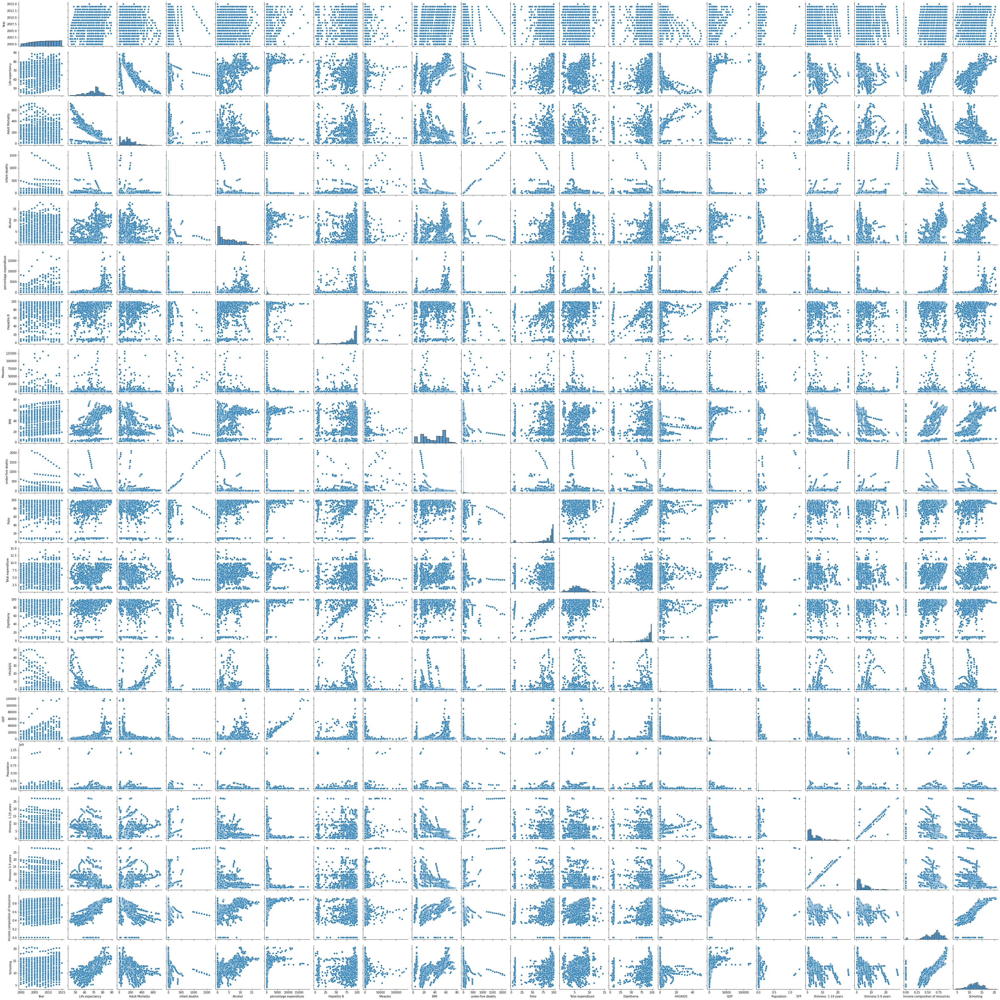

In [11]:
sns.pairplot(data)

In [16]:
data.corr()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
Year,1.000000,0.050771,-0.037092,0.008029,-0.113365,0.069553,0.114897,-0.053822,0.005739,0.010479,-0.016699,0.059493,0.029641,-0.123405,0.096421,0.012567,0.019757,0.014122,0.122892,0.088732
Life expectancy,0.050771,1.000000,-0.702523,-0.169074,0.402718,0.409631,0.199935,-0.068881,0.542042,-0.192265,0.327294,0.174718,0.341331,-0.592236,0.441322,-0.022305,-0.457838,-0.457508,0.721083,0.727630
Adult Mortality,-0.037092,-0.702523,1.000000,0.042450,-0.175535,-0.237610,-0.105225,-0.003967,-0.351542,0.060365,-0.199853,-0.085227,-0.191429,0.550691,-0.255035,-0.015012,0.272230,0.286723,-0.442203,-0.421171
infant deaths,0.008029,-0.169074,0.042450,1.000000,-0.106217,-0.090765,-0.231769,0.532680,-0.234425,0.996906,-0.156929,-0.146951,-0.161871,0.007712,-0.098092,0.671758,0.463415,0.461908,-0.134754,-0.214372
Alcohol,-0.113365,0.402718,-0.175535,-0.106217,1.000000,0.417047,0.109889,-0.050110,0.353396,-0.101082,0.240315,0.214885,0.242951,-0.027113,0.443433,-0.028880,-0.403755,-0.386208,0.561074,0.616975
percentage expenditure,0.069553,0.409631,-0.237610,-0.090765,0.417047,1.000000,0.016760,-0.063071,0.242738,-0.092158,0.128626,0.183872,0.134813,-0.095085,0.959299,-0.016792,-0.255035,-0.255635,0.402170,0.422088
Hepatitis B,0.114897,0.199935,-0.105225,-0.231769,0.109889,0.016760,1.000000,-0.124800,0.143302,-0.240766,0.463331,0.113327,0.588990,-0.094802,0.041850,-0.129723,-0.129406,-0.133251,0.184921,0.215182
Measles,-0.053822,-0.068881,-0.003967,0.532680,-0.050110,-0.063071,-0.124800,1.000000,-0.153245,0.517506,-0.057850,-0.113583,-0.058606,-0.003522,-0.064768,0.321946,0.180642,0.174946,-0.058277,-0.115660
BMI,0.005739,0.542042,-0.351542,-0.234425,0.353396,0.242738,0.143302,-0.153245,1.000000,-0.242137,0.186268,0.189469,0.176295,-0.210897,0.266114,-0.081416,-0.547018,-0.554094,0.510505,0.554844
under-five deaths,0.010479,-0.192265,0.060365,0.996906,-0.101082,-0.092158,-0.240766,0.517506,-0.242137,1.000000,-0.171164,-0.145803,-0.178448,0.019476,-0.100331,0.658680,0.464785,0.462289,-0.148097,-0.226013


In [24]:
# import plotly.express as px
# from urllib.request import urlopen
# import json
# with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#     counties = json.load(response)
# fig = px.choropleth(data, geojson=counties, locations='Country', color='Life expectancy ',
#                            color_continuous_scale="Viridis",
#                            range_color=(0, 12)
#                           )
# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()

In [32]:
from scipy.stats import kstest
from scipy.stats import norm

In [62]:
for c in data.columns:
    if data[c].dtype=="O":
        continue
    n = norm(loc=data[c].mean(), scale=data[c].std())
    print(f"KS test results for - {c}")
    print(kstest(data[c],n.cdf))
    print("===============================================================")

KS test results for - Year
KstestResult(statistic=0.09677188220208266, pvalue=6.814974762166233e-14)
KS test results for - Life expectancy 
KstestResult(statistic=0.1156309726070261, pvalue=1.1536138937277757e-19)
KS test results for - Adult Mortality
KstestResult(statistic=0.09889892623159624, pvalue=1.7149164896997564e-14)
KS test results for - infant deaths
KstestResult(statistic=0.39382103711152516, pvalue=5.044473614594127e-231)
KS test results for - Alcohol
KstestResult(statistic=0.13080221521044155, pvalue=4.641616769018773e-25)
KS test results for - percentage expenditure
KstestResult(statistic=0.3455664716626292, pvalue=2.1233670407137058e-176)
KS test results for - Hepatitis B
KstestResult(statistic=0.21987808114545104, pvalue=1.7199670632030415e-70)
KS test results for - Measles 
KstestResult(statistic=0.4127186926387287, pvalue=1.1152767236849034e-254)
KS test results for -  BMI 
KstestResult(statistic=0.11679940848192938, pvalue=4.681938018122352e-20)
KS test results for -

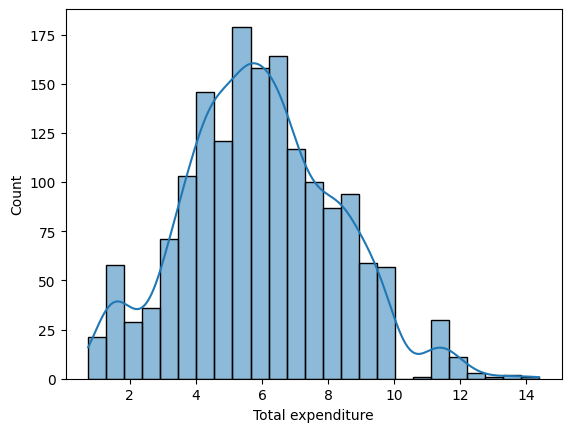

In [68]:
# Considering 5% significance level
# Only Schooling and Total expenditure
sns.histplot(data['Total expenditure'],bins=25,kde=True);
# p value is 0.056, so we can say that it is similar to a normal distribution
# with mean 5.955 and std deviation 2.299

<AxesSubplot:xlabel='Schooling', ylabel='Count'>

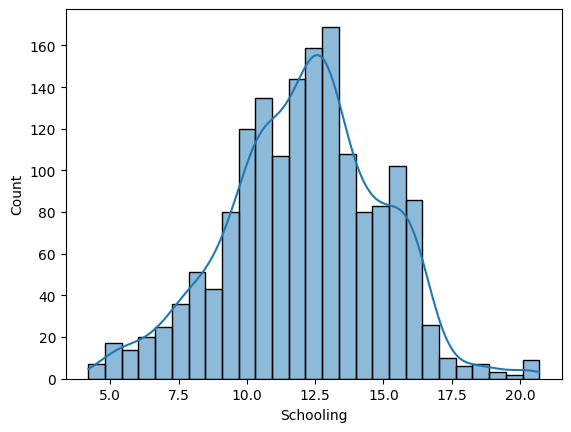

In [71]:
sns.histplot(data['Schooling'],kde=True)
# As p value is 0.085, we can say that its distribution is 
# similar to a normal distribution with mean 12.11 and std dev 2.79

<AxesSubplot:xlabel=' HIV/AIDS', ylabel='Count'>

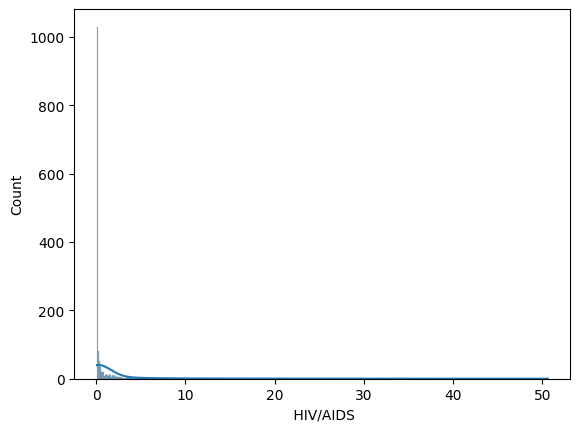

In [79]:
sns.histplot(data[' HIV/AIDS'],kde=True)
# plt.xlim(0,2)
# Looks like exponential distribution

<AxesSubplot:xlabel='Income composition of resources', ylabel='Count'>

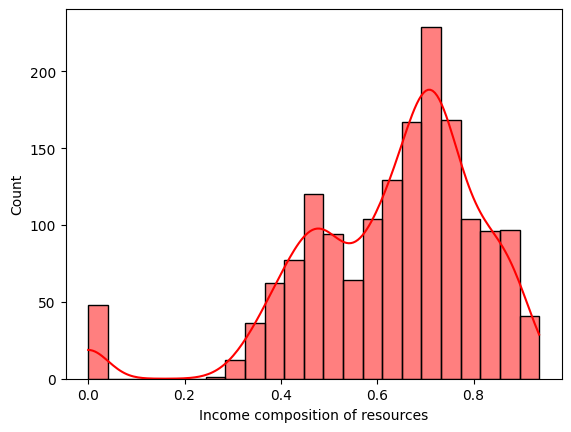

In [88]:
# sns.histplot(data['Adult Mortality'],kde=True)
sns.histplot(data['Income composition of resources'],kde=True,color='r')

In [7]:
import plotly.express as px

In [5]:
# The plot below may not appear in the submitted notebook
# So I am adding the image in markdown below
fig = px.scatter(
    data,x='GDP',y="Life expectancy ",
    size="Population", color="Country",
    hover_name="Country",log_x=True,size_max=40
)
fig.show()
# Size of bubble defines the population
# Countries with high GDP and low population have greater life expectancy
# I can see that countries like Nigeria, Cameroon, Uganda, etc
# ie the ones in Africa have lower life expectancy

#### Life expectancy by country and population
![](./bubble.png)

In [18]:
# Data scaling
from sklearn.preprocessing import StandardScaler
s = StandardScaler()

In [118]:
data.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

In [72]:
X = data.drop("Life expectancy ",axis=1)
X = data.drop("Year",axis=1)
y = data['Life expectancy ']
# X.drop('Life expectancy ',inplace=True)

In [74]:
X = X[['Country', 'Status',  'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling']]
X.columns

Index(['Country', 'Status', 'Adult Mortality', 'infant deaths', 'Alcohol',
       'percentage expenditure', 'Hepatitis B', 'Measles ', ' BMI ',
       'under-five deaths ', 'Polio', 'Total expenditure', 'Diphtheria ',
       ' HIV/AIDS', 'GDP', 'Population', ' thinness  1-19 years',
       ' thinness 5-9 years', 'Income composition of resources', 'Schooling'],
      dtype='object')

In [75]:
from sklearn.linear_model import LinearRegression

In [76]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(pd.get_dummies(X),y,test_size=0.3)
lr = LinearRegression()

In [77]:
lr.fit(X_train,y_train)

LinearRegression()

In [78]:
lc = lr.score(X_test,y_test)
lc
# R square is coming out to be well, so our model has performed optimally

0.9523775518835056

In [79]:
y_pred_who = lr.predict(X_test)
mean_absolute_percentage_error(y_test,y_pred_who)

0.017209853842897478

In [80]:
from sklearn import linear_model

In [81]:
ls = linear_model.Lasso()
ls.fit(X_train,y_train)

D:\anaconda_dist\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.000e+04, tolerance: 8.860e+00
  model = cd_fast.enet_coordinate_descent(


Lasso()

In [82]:
lsc = ls.score(X_test,y_test)
lsc

0.8114384492175528

In [56]:
len(ls.coef_)

154

In [83]:
y_pred_who_lasso = lr.predict(X_test)
mean_absolute_percentage_error(y_test,y_pred_who_lasso)

0.017209853842897478

In [84]:
len(ls.feature_names_in_)

153

In [85]:
features_weights = {}
for f,w in zip(ls.feature_names_in_,ls.coef_):
    features_weights[f] = w
features_weights
# As we can see, it has 0 weights for country name
# Also, Lasso assigns zero weights to not important features, 
# So this is the feature selection process,
# The ones

{'Adult Mortality': -0.02059083023041603,
 'infant deaths': 0.08183668455725317,
 'Alcohol': 0.0,
 'percentage expenditure': 0.00019470403813535596,
 'Hepatitis B': -0.0058418755438629745,
 'Measles ': 7.125600020078149e-06,
 ' BMI ': 0.05710363205896396,
 'under-five deaths ': -0.06341415610307108,
 'Polio': 0.010461094373476507,
 'Total expenditure': 0.0,
 'Diphtheria ': 0.02572920557197026,
 ' HIV/AIDS': -0.43867722182115515,
 'GDP': 8.002386648967804e-05,
 'Population': 1.140410374231837e-09,
 ' thinness  1-19 years': -0.0017696585548268322,
 ' thinness 5-9 years': -0.0,
 'Income composition of resources': 0.0,
 'Schooling': 0.9798489843646874,
 'Country_Afghanistan': -0.0,
 'Country_Albania': 0.0,
 'Country_Algeria': 0.0,
 'Country_Angola': -0.0,
 'Country_Argentina': -0.0,
 'Country_Armenia': 0.0,
 'Country_Australia': -0.0,
 'Country_Austria': 0.0,
 'Country_Azerbaijan': 0.0,
 'Country_Bangladesh': 0.0,
 'Country_Belarus': -0.0,
 'Country_Belgium': 0.0,
 'Country_Belize': -0.0,


In [87]:
for k,v in features_weights.items():
    if v!=0:
        print(k,v)

Adult Mortality -0.02059083023041603
infant deaths 0.08183668455725317
percentage expenditure 0.00019470403813535596
Hepatitis B -0.0058418755438629745
Measles  7.125600020078149e-06
 BMI  0.05710363205896396
under-five deaths  -0.06341415610307108
Polio 0.010461094373476507
Diphtheria  0.02572920557197026
 HIV/AIDS -0.43867722182115515
GDP 8.002386648967804e-05
Population 1.140410374231837e-09
 thinness  1-19 years -0.0017696585548268322
Schooling 0.9798489843646874


In [88]:
import statsmodels.api as sm

In [89]:
X_train_c = sm.add_constant(X_train)
model = sm.OLS(y_train, X_train_c)
results = model.fit()
print(results.summary())
# We can interpret the p values as 
# The Adult Mortality has a p value of 0, which suggests that
# it has high effect on Life expectancy
# infant deaths has p value of 0.081, which suggests that there is only
# 8% chance that infant deaths has no effect on Life expectancy
# And so on..

                            OLS Regression Results                            
Dep. Variable:       Life expectancy    R-squared:                       0.967
Model:                            OLS   Adj. R-squared:                  0.962
Method:                 Least Squares   F-statistic:                     193.5
Date:                Sun, 11 Sep 2022   Prob (F-statistic):               0.00
Time:                        11:27:19   Log-Likelihood:                -2180.8
No. Observations:                1154   AIC:                             4664.
Df Residuals:                    1003   BIC:                             5426.
Df Model:                         150                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

In [90]:
results.tvalues

const                     50.756111
Adult Mortality           -1.459709
infant deaths              1.669288
Alcohol                   -2.411662
percentage expenditure    -0.732197
                            ...    
Country_Vanuatu            8.902565
Country_Zambia            -8.363615
Country_Zimbabwe         -11.138633
Status_Developed          38.946531
Status_Developing         58.170292
Length: 154, dtype: float64

In [19]:
from mlxtend.feature_selection import SequentialFeatureSelector as sfs
from sklearn.linear_model import LinearRegression
clf = LinearRegression()

# Build step forward feature selection
sfs1 = sfs(clf,k_features = 10,forward=True,floating=False, scoring='r2',cv=5)
# sfs2 = sfs(clf,k_features = 10,forward=False,floating=False, scoring='r2',cv=5)
# Perform SFFS
sfs1 = sfs1.fit(X_train, y_train)
# sfs2 = sfs2.fit(X_train, y_train)

In [16]:
# !pip install mlxtend 
sfs1.subsets_

{1: {'feature_idx': (0,),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_names': ('Life expectancy ',)},
 2: {'feature_idx': (0, 1),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_names': ('Life expectancy ', 'Adult Mortality')},
 3: {'feature_idx': (0, 1, 2),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_names': ('Life expectancy ', 'Adult Mortality', 'infant deaths')},
 4: {'feature_idx': (0, 1, 2, 3),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_names': ('Life expectancy ',
   'Adult Mortality',
   'infant deaths',
   'Alcohol')},
 5: {'feature_idx': (0, 1, 2, 3, 4),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_names': ('Life expectancy ',
   'Adult Mortality',
   'infant deaths',
   'Alcohol',
   'percentage expenditure')},
 6: {'feature_idx': (0, 1, 2, 3, 4, 5),
  'cv_scores': array([1., 1., 1., 1., 1.]),
  'avg_score': 1.0,
  'feature_na